In [2]:
%config Completer.use_jedi = False
import os

import numpy as np
import pandas as pd

import anndata
import scanpy as sc

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection
from matplotlib import gridspec
import matplotlib as mpl
import seaborn as sns

from collections import defaultdict
import random
    
print('Load interaction') 
fn_int = '/home/yike/phd/dengue/data/interaction_source_file/interactions_DB.tsv'
interactions = pd.read_csv(fn_int, sep=',')[['gene_name_a', 'gene_name_b']]

print('Load high-quality cells only')
fn_h5ad = '/home/yike/phd/dengue/data/mergedata_20210519_hq_cts.h5ad'
adata = sc.read_h5ad(fn_h5ad)
print('normalize data to CPM (counts per million)')
sc.pp.normalize_total(adata, target_sum=1e6)
        
print('Restrict to interaction genes')
genes = np.unique(interactions)
genes = [i for i in genes if i in adata.var_names] # genes = genes - ['CCL3L3', 'CCL4L1', 'CCN6', 'KIR3DS1', 'YARS1']
adatag = adata[:, genes]

Load interaction
Load high-quality cells only
normalize data to CPM (counts per million)
Restrict to interaction genes


In [3]:
adata_children = adata[adata.obs['dataset'] == 'child']
adata_adults = adata[adata.obs['dataset'] == 'adult']
from adata_utilis import split_adata
print('split adata to [sick/condition, dataset]')
adata_dic = split_adata(adata)

split adata to [sick/condition, dataset]


In [4]:
import sys
sys.path.append('/home/yike/phd/dengue/dengue_children') #enter the YK_util file directory
import YK_util, optimized_pair_comparison
from YK_util import *
from optimized_pair_comparison import *

In [4]:
#adata_o = adata_children[adata_children.obs['cell_type'] == 'cDCs']
csts = adata_children.obs['cell_subtype_2'].unique().tolist()
csts.remove('doublets')
pair = pair_comparison(adata_children, csts)

pair['pair_res'].to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/original/pair.tsv', sep='\t', index=False)
pair['log_FCs'].to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/original/log2FC.tsv', sep='\t')

fra_av = fra_avg(adata_children, csts)
fra_av['fra'].to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/original/fra.tsv', sep='\t', index=False)
fra_av['avg'].to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/original/avg.tsv', sep='\t', index=False)

data = combination(pair['pair_res'], fra_av['fra'], fra_av['avg'])
data.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/original/data_pair.tsv', sep='\t')

In [127]:
print('get the number of interactions at SD and D, threshold: exp frac >= 2%')

inters = defaultdict(list)

exp_frac = pd.read_csv('/home/yike/phd/dengue/data/excels/log2_fc/S_dengue_vs_dengue/20210625_figure_4_code/exp.tsv', index_col=['cell_type', 'condition'])

for _, row in interactions.iterrows():
    ga = row['gene_name_a']
    gb = row['gene_name_b']
    if (ga not in genes) | (gb not in genes):
        continue
    for cd, col in zip(['S_dengue', 'dengue'], ['S_fra', 'NS_fra']):
        for cst1 in csts:
            for cst2 in csts:
                exp = {(gene, cst, cd): data.loc[cst, gene][col] for gene in [ga, gb] for cst in [cst1, cst2]}

                if (exp[ga, cst1, cd] >= 0.02) & (exp[gb, cst2, cd] >= 0.02):
                    inters[(cst1, cst2, cd)].append([ga, gb])
                if (exp[ga, cst2, cd] >= 0.02) & (exp[gb, cst1, cd] >= 0.02):
                    inters[(cst1, cst2, cd)].append([gb, ga])
                
for key in inters.keys():
    if key[0] == key[1]:
        inters[key] = inters[key][::2]
        
its = pd.DataFrame([])
for key in inters.keys():
    inter = pd.DataFrame(inters[key], columns=['ga', 'gb'])
    inter['cell_subtype1'] = [key[0]] * len(inters[key])
    inter['cell_subtype2'] = [key[1]] * len(inters[key])
    inter['condition'] = [key[2]] * len(inters[key])
    
    its = pd.concat([its, inter])

its.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/inters_cd_002.tsv', sep='\t', index=False)

get the number of interactions at SD and D, threshold: exp frac >= 2%


In [ ]:
inters_im = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/inters_cd_002.tsv', sep='\t', index_col=['cell_subtype1', 'cell_subtype2', 'condition'])
intern_im = {}
for key in inters_im.index:
    intern_im[key] = inters_im.loc[key].shape[0]
    
colors_im = {}
norm_intern_im = {}
vmin, vmax = 0, 350

for key in intern_im.keys():
    norm_intern_im[key] = (min(intern_im[(key)], vmax) - vmin)/(vmax - vmin)
    colors_im[key] = plt.cm.get_cmap('plasma')(norm_intern_im[key])
#######################################################################
print('get the heatmap showing the number of interactions at SD and D')
it_im = pd.DataFrame([])
ls_im = defaultdict(list)

# cell_types = ['B_cells', 'Monocytes', 'NK_cells', 'Plasmablasts', 'T_cells', 'cDCs', 'pDCs']

for cst1 in csts:
    for cst2 in csts:
        ls_im[cst1].append(intern_im[(cst1, cst2, 'S_dengue')])
    it_im[cst1] = ls_im[cst1]
    
it_im.index = pd.Index(csts)  

from scipy.spatial.distance import pdist 
distance = pdist(it_im.values) 

from scipy.cluster.hierarchy import linkage, leaves_list
lkg = linkage(distance, optimal_ordering=True)
best_order_im = leaves_list(lkg) 

it_im_new = it_im.iloc[best_order_im]
cts_im_op = list(it_im_new.index)

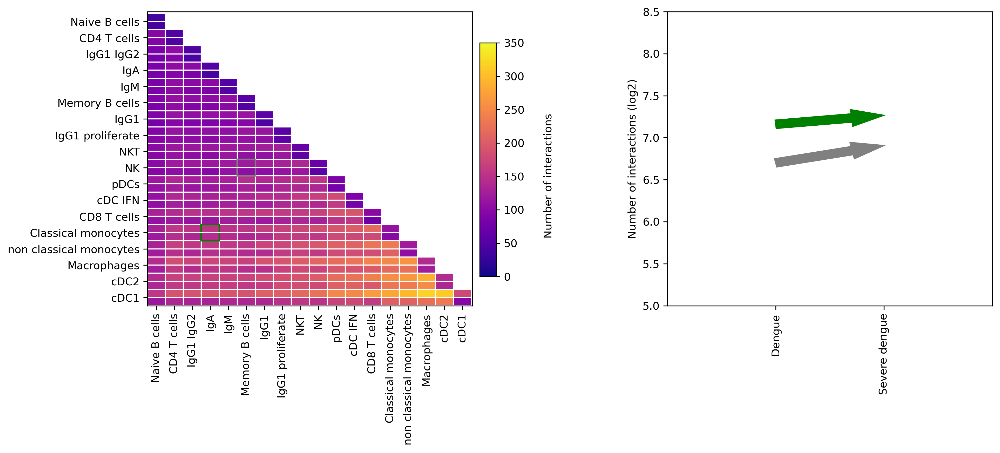

In [159]:
fig, axs = plt.subplots(1, 2, figsize=[14, 5], dpi=300) 
plt.subplots_adjust(wspace=0.6)

###############################
for a in range(len(cts_im_op)):
    for b in range(len(cts_im_op)):
        axs[0].axhline(b+0.5, c='white', lw=0.4)
        
        if a+b <= len(cts_im_op) - 1:
            dots1 = [[a, b+0.5],
                    [a+1, b+0.5],
                    [a+1, b+1],
                    [a, b+1],
            ]
            e1 = mpatches.Polygon(np.array(dots1), facecolor=colors_im[(list(reversed(cts_im_op))[a], cts_im_op[b], 'S_dengue')], edgecolor='white')
            axs[0].add_patch(e1)

            dots2 = [[a, b],
                    [a+1, b],
                    [a+1, b+0.5],
                    [a, b+0.5],
            ]
            e2 = mpatches.Polygon(np.array(dots2), facecolor=colors_im[(list(reversed(cts_im_op))[a], cts_im_op[b], 'dengue')], edgecolor='white')
            axs[0].add_patch(e2)
            
            if (list(reversed(cts_im_op))[a], cts_im_op[b]) == ('IgA', 'Classical_monocytes'):
                axs[0].plot([a, a+1], [b, b], color='green')
                axs[0].plot([a+1, a+1], [b, b+1], color='green')
                axs[0].plot([a, a+1], [b+1, b+1], color='green')
                axs[0].plot([a, a], [b, b+1], color='green')
                
            elif (list(reversed(cts_im_op))[a], cts_im_op[b]) == ('Memory_B_cells', 'NK'):
                axs[0].plot([a, a+1], [b, b], color='gray')
                axs[0].plot([a+1, a+1], [b, b+1], color='gray')
                axs[0].plot([a, a+1], [b+1, b+1], color='gray')
                axs[0].plot([a, a], [b, b+1], color='gray')

axs[0].set_xlim([0, len(cts_im_op) + 0.05])
axs[0].set_ylim([0, len(cts_im_op) + 0.1])
axs[0].set_xticks([i + 0.5 for i in range(len(cts_im_op))])
axs[0].set_yticks([i + 0.5 for i in range(len(cts_im_op))])

labels = [i.replace('_', ' ') for i in cts_im_op]
axs[0].set_xticklabels(list(reversed(labels)), rotation=90)
axs[0].set_yticklabels(labels)

#vmin, vmax = 0, 350
norm_im = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
cmap_im = plt.cm.get_cmap('plasma')
position_im = fig.add_axes([0.43, 0.2, 0.015, 0.6])
cbar_im = plt.colorbar(plt.cm.ScalarMappable(norm=norm_im, cmap=cmap_im), cax=position_im, ax=axs[0], fraction=0.01, pad=0.01, orientation='vertical')

axs[0].text(len(cts_im_op) + 4, 8, 'Number of interactions', verticalalignment='center', rotation=90)

##################################
y_green = [np.log2(intern_im['IgA', 'Classical_monocytes', 'dengue']), 
          np.log2(intern_im['IgA', 'Classical_monocytes', 'S_dengue'])]

y_gray = [np.log2(intern_im['Memory_B_cells', 'NK', 'dengue']), 
          np.log2(intern_im['Memory_B_cells', 'NK', 'S_dengue'])]


axs[1].arrow(1, y_green[0], 1, y_green[1] - y_green[0], length_includes_head=True, color='green', width=0.1, head_width=0.2)
axs[1].arrow(1, y_gray[0], 1, y_gray[1] - y_gray[0], length_includes_head=True, color='gray', width=0.1, head_width=0.2) 

axs[1].set_xlim(0, 3)
axs[1].set_xticks([1, 2])
axs[1].set_xticklabels(['Dengue', 'Severe dengue'], rotation=90)
axs[1].set_ylim(5, 8.5)
axs[1].set_ylabel('Number of interactions (log2)')

plt.show()

In [194]:
data_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/data_pair.tsv', sep='\t', index_col=['cell_subtype_2', 'gene'])
#################
csts = adata_children.obs['cell_subtype_2'].unique().tolist()
csts.remove('doublets')
cts = csts
#################
cst_idx = [(cst, gene) for cst in csts for gene in genes]
data_cst = data_cst.loc[cst_idx]
data_ct = data_cst

In [195]:
fn_int = '/home/yike/phd/dengue/data/interaction_source_file/interactions_DB.tsv'
interactions = pd.read_csv(fn_int, sep=',')[['gene_name_a', 'gene_name_b']]
res = []
for _, row in interactions.iterrows():
    ga = row['gene_name_a']
    gb = row['gene_name_b']
    if (ga not in genes) | (gb not in genes):
        continue
    for cst in csts:
        cst_med = {gene: data_cst.loc[cst, gene]['med_pair'] for gene in [ga, gb]} 
        cst_fra_pair = {gene: data_cst.loc[cst, gene]['fra_pair'] for gene in [ga, gb]} 
        cst_fra = {(gene, cd): data_cst.loc[cst, gene][cd+'_fra'] for gene in [ga, gb] for cd in ['S', 'NS']}
        for ct in cts:
            ct_med = {gene: data_ct.loc[ct, gene]['med_pair'] for gene in [ga, gb]}
            ct_fra_pair = {gene: data_ct.loc[ct, gene]['fra_pair'] for gene in [ga, gb]}
            ct_fra = {(gene, cd): data_ct.loc[ct, gene][cd+'_fra'] for gene in [ga, gb] for cd in ['S', 'NS']}

            if (cst_med[ga] > 1) & (ct_med[gb] > 1) & (cst_fra[ga, 'S'] > 0.02) & (ct_fra[gb, 'S'] > 0.02):
                res.append([
                    ga, cst, cst_med[ga], cst_fra_pair[ga], cst_fra[ga, 'S'], cst_fra[ga, 'NS'],
                    gb, ct, ct_med[gb], ct_fra_pair[gb], ct_fra[gb, 'S'], ct_fra[gb, 'NS'], 'up'
                ])
            if (cst_med[gb] > 1) & (ct_med[ga] > 1) & (cst_fra[gb, 'S'] > 0.02) & (ct_fra[ga, 'S'] > 0.02):
                res.append([
                    gb, cst, cst_med[gb], cst_fra_pair[gb], cst_fra[gb, 'S'], cst_fra[gb, 'NS'],
                    ga, ct, ct_med[ga], ct_fra_pair[ga], ct_fra[ga, 'S'], ct_fra[ga, 'NS'], 'up'
                ])
            #####################
            if (cst_med[ga] < -1) & (ct_med[gb] < -1) & (cst_fra[ga, 'NS'] > 0.02) & (ct_fra[gb, 'NS'] > 0.02):
                res.append([
                    ga, cst, cst_med[ga], cst_fra_pair[ga], cst_fra[ga, 'S'], cst_fra[ga, 'NS'],
                    gb, ct, ct_med[gb], ct_fra_pair[gb], ct_fra[gb, 'S'], ct_fra[gb, 'NS'], 'down'
                ])
            if (cst_med[gb] < -1) & (ct_med[ga] < -1) & (cst_fra[gb, 'NS'] > 0.02) & (ct_fra[ga, 'NS'] > 0.02):
                res.append([
                    gb, cst, cst_med[gb], cst_fra_pair[gb], cst_fra[gb, 'S'], cst_fra[gb, 'NS'],
                    ga, ct, ct_med[ga], ct_fra_pair[ga], ct_fra[ga, 'S'], ct_fra[ga, 'NS'], 'down'
                ])
            #####################
            if (cst_med[ga] > 1) & (ct_med[gb] < -1) & (cst_fra[ga, 'S'] > 0.02) & (ct_fra[gb, 'NS'] > 0.02):
                res.append([
                    ga, cst, cst_med[ga], cst_fra_pair[ga], cst_fra[ga, 'S'], cst_fra[ga, 'NS'],
                    gb, ct, ct_med[gb], ct_fra_pair[gb], ct_fra[gb, 'S'], ct_fra[gb, 'NS'], 'mix'
                ])
                
            if (cst_med[ga] < -1) & (ct_med[gb] > 1) & (cst_fra[ga, 'NS'] > 0.02) & (ct_fra[gb, 'S'] > 0.02):
                res.append([
                    gb, ct, ct_med[gb], ct_fra_pair[gb], ct_fra[gb, 'S'], ct_fra[gb, 'NS'], 
                    ga, cst, cst_med[ga], cst_fra_pair[ga], cst_fra[ga, 'S'], cst_fra[ga, 'NS'], 'mix'
                ])
                
            if (cst_med[gb] > 1) & (ct_med[ga] < -1) & (cst_fra[gb, 'S'] > 0.02) & (ct_fra[ga, 'NS'] > 0.02):
                res.append([
                    gb, cst, cst_med[gb], cst_fra_pair[gb], cst_fra[gb, 'S'], cst_fra[gb, 'NS'],
                    ga, ct, ct_med[ga], ct_fra_pair[ga], ct_fra[ga, 'S'], ct_fra[ga, 'NS'], 'mix'
                ])
            if (cst_med[gb] < -1) & (ct_med[ga] > 1) & (cst_fra[gb, 'NS'] > 0.02) & (ct_fra[ga, 'S'] > 0.02):
                res.append([
                    ga, ct, ct_med[ga], ct_fra_pair[ga], ct_fra[ga, 'S'], ct_fra[ga, 'NS'], 
                    gb, cst, cst_med[gb], cst_fra_pair[gb], cst_fra[gb, 'S'], cst_fra[gb, 'NS'], 'mix'
                ])

res = pd.DataFrame(res, columns=[
    'ga', 'csta', 'ga_med_pair', 'ga_fra_pair','ga_SD_fra', 'ga_D_fra', 
    'gb', 'cstb', 'gb_med_pair', 'gb_fra_pair','gb_SD_fra', 'gb_D_fra',
    'inter_type'])

In [248]:
def randomization(genes):
    log2fc = defaultdict(list)
    r = defaultdict(list)
    pvalue = {}
    
    for i, inter in enumerate(genes):
        if i % 100 == 0:
            print(i)
        ga = inter['ga']
        cta = inter['cta']
        gb = inter['gb']
        ctb = inter['ctb']

        adata_g = {}
        adata_children = adata[adata.obs['dataset'] == 'child']
        
        for gene, ct in zip([ga, gb], [cta, ctb]):
            adata_ct = adata_children[adata_children.obs['cell_subtype_2'] == ct]
            IDs = list(adata_ct.obs['ID'].astype('category').cat.categories)
            for ID in IDs:
                adata_ID = adata_ct[adata_ct.obs['ID'] == ID]
                if len(adata_ID.obs_names) < 5:
                    IDs.remove(ID)
            adata_ct = adata_ct[adata_ct.obs['ID'].isin(IDs)]
            adata_g[gene] = adata_ct[:, gene]  
            
        avg = {(gene, cd): adata_g[gene][adata_g[gene].obs['Condition'] == cd].X.toarray().mean() for gene in [ga, gb] for cd in ['S_dengue', 'dengue']}
        lfc = {gene: np.log2(avg[gene, 'S_dengue'] + 0.1) - np.log2(avg[gene, 'dengue'] + 0.1) for gene in [ga, gb]}
        log2fc[(ga, cta, gb, ctb)].append([lfc[ga], lfc[gb]])
        r0 = (float(lfc[ga])**2 + float(lfc[gb])**2)**0.5
        r[(ga, cta, gb, ctb)].append(r0)
        
        p = 0
        for i in range(1000):
            adata_i = adata_g
            raw = {gene: adata_i[gene].obs['Condition'].tolist() for gene in [ga, gb]}
            for gene in [ga, gb]:
                random.shuffle(raw[gene])
                adata_i[gene].obs['Condition'] = raw[gene]
            avg_i = {(gene, cd): adata_i[gene][adata_i[gene].obs['Condition'] == cd].X.toarray().mean() for gene in [ga, gb] for cd in ['S_dengue', 'dengue']}
            log2fc_i = {gene: np.log2(avg_i[gene, 'S_dengue'] + 0.1) - np.log2(avg_i[gene, 'dengue'] + 0.1) for gene in [ga, gb]}
            log2fc[(ga, cta, gb, ctb)].append([log2fc_i[ga], log2fc_i[gb]])
            ri = (float(log2fc_i[ga])**2 + float(log2fc_i[gb])**2)**0.5
            r[(ga, cta, gb, ctb)].append(ri)
            if ri >= r0:
                p += 1
        pvalue[(ga, cta, gb, ctb)] = p * 0.001

    res = pd.DataFrame([])
    for key in log2fc.keys():
        log2fc[key] = pd.DataFrame(log2fc[key], columns = ['log2fc_ga', 'log2fc_gb'])
        log2fc[key]['r'] = r[key]
        log2fc[key]['pvalue'] = pvalue[key]
        for j, s in enumerate(['ga', 'cta', 'gb', 'ctb']):
            log2fc[key][s] = key[j]
        res = pd.concat([res, log2fc[key]])
    res = res.set_index(['ga', 'cta', 'gb', 'ctb'])
        
    return res

In [ ]:
csts = adata_children.obs['cell_subtype_2'].unique().tolist()
csts.remove('doublets')

idx = []
for i, cst1 in enumerate(csts):
    cstsi = csts[i:]
    for cst2 in cstsi:
        idx.append((cst2, cst1))
idx = [i for i in idx if i in res_du.index.tolist()]

res_du = res[res['inter_type'].isin(['up', 'down'])]
res_du.set_index(['csta', 'cstb'], inplace=True)
res_ud = res_du.loc[idx]
res_ud.reset_index(inplace=True)
res_m = res[res['inter_type'] == 'mix']
res_n = pd.concat([res_ud, res_m])
res = res_n
res_n = res_n[~res_n.duplicated()]
res_n.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/inters_cst_nsym.tsv', sep='\t')

In [275]:
res = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/inters_cst_nsym.tsv', sep='\t')
res_r = res[
    ((res['ga_fra_pair'] > 0.5) & (res['gb_fra_pair'] > 0.5) & (res['inter_type'] == 'up')) |
    ((res['ga_fra_pair'] < 0.5) & (res['gb_fra_pair'] < 0.5) & (res['inter_type'] == 'down')) |
    ((res['ga_fra_pair'] > 0.5) & (res['gb_fra_pair'] < 0.5) & (res['inter_type'] == 'mix')) 
]
r_genes = [{'ga': ga, 'cta': cta, 'gb': gb, 'ctb': ctb} for ga, cta, gb, ctb in zip(res_r['ga'].tolist(), res_r['csta'].tolist(), res_r['gb'].tolist(), res_r['cstb'].tolist())]
ran_res = randomization(r_genes)
ran_res = ran_res[~ran_res.duplicated()]
ran_res.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/randomization_inters_cst.tsv')

In [251]:
def ran_filter(ran_res, genes):
    sig_res = pd.DataFrame([], columns = ['log2fc_ga', 'log2fc_gb', 'r', 'pvalue', 'ga', 'csta', 'gb', 'cstb'])
    i = 0
    
    for inter in genes:
        ga = inter['ga']
        csta = inter['cta']
        gb = inter['gb']
        cstb = inter['ctb']
        if ran_res.loc[ga, csta, gb, cstb][:1]['pvalue'][0] == 0:
            i += 1
            loc = ran_res.loc[ga, csta, gb, cstb][:1].loc[ga, csta, gb, cstb].tolist()
            for j in [ga, csta, gb, cstb]:
                loc.append(j)
            sig_res.loc[i] = loc
    return sig_res

In [252]:
ran_filter = ran_filter(ran_res, r_genes)
ran_filter = ran_filter[~ran_filter.duplicated()]
ran_filter.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/ran_filter_inters_cst_nsem.tsv', sep='\t', index=False)

<ipython-input-251-a565af1a3728>:10: PerformanceWarning: indexing past lexsort depth may impact performance.
  if ran_res.loc[ga, csta, gb, cstb][:1]['pvalue'][0] == 0:
<ipython-input-251-a565af1a3728>:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  loc = ran_res.loc[ga, csta, gb, cstb][:1].loc[ga, csta, gb, cstb].tolist()


In [293]:
ran_filter.set_index(['ga', 'csta', 'gb', 'cstb'], inplace=True)
res.set_index(['ga', 'csta', 'gb', 'cstb'], inplace=True)
ran_inters = res.loc[ran_filter.index]
ran_inters.drop('Unnamed: 0', axis=1, inplace=True)
ran_inters = ran_inters[~ran_inters.duplicated()]
ran_inters.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/pair_filter_inters_cst_nsem.tsv', sep='\t')

In [269]:
def randomization_plot(fdn, ran_filter, ran_res):
    ran_genes = [{'ga': idx[0], 'cta': idx[1], 'gb': idx[2], 'ctb': idx[3]} for idx in ran_filter.index]
    for inter in ran_genes:
        fig, ax = plt.subplots(figsize=[3, 3], dpi=300)
        ga = inter['ga']
        cta = inter['cta']
        gb = inter['gb']
        ctb = inter['ctb']

        log2fc = ran_res.loc[ga, cta, gb, ctb]

        x0 = log2fc['log2fc_ga'].tolist()[0]
        y0 = log2fc['log2fc_gb'].tolist()[0]    

        x = log2fc['log2fc_ga'].tolist()[1:]
        y = log2fc['log2fc_gb'].tolist()[1:]

        ax.scatter(x0, y0, c='r', s=10)
        ax.scatter(x, y, c='blue', s=2)
        ax.axvline(0, c='gray', zorder=-3, lw=0.5)
        ax.axhline(0, c='gray', zorder=-3, lw=0.5)
        ax.set_ylim(-4, 4)
        ax.set_xlim(-4, 4)
        ax.set_xlabel('Log2fc of ' + ga + ' in ' + cta.replace('_', ' '))
        ax.set_ylabel('Log2fc of ' + gb + ' in ' + ctb.replace('_', ' '))
        p = ran_res.loc[ga, cta, gb, ctb]['pvalue'][0]
        if p == 0:
            ax.set_title('p value < 0.001')
        else:
            ax.set_title('p value: ' + str(p))
        plt.savefig(fdn + ga + '_in_' + cta + '&' + gb + '_in_' + ctb + '.png', bbox_inches = 'tight')
#######################################################################

<ipython-input-269-61d6c2315d76>:10: PerformanceWarning: indexing past lexsort depth may impact performance.
  log2fc = ran_res.loc[ga, cta, gb, ctb]
<ipython-input-269-61d6c2315d76>:26: PerformanceWarning: indexing past lexsort depth may impact performance.
  p = ran_res.loc[ga, cta, gb, ctb]['pvalue'][0]
<ipython-input-269-61d6c2315d76>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=[3, 3], dpi=300)


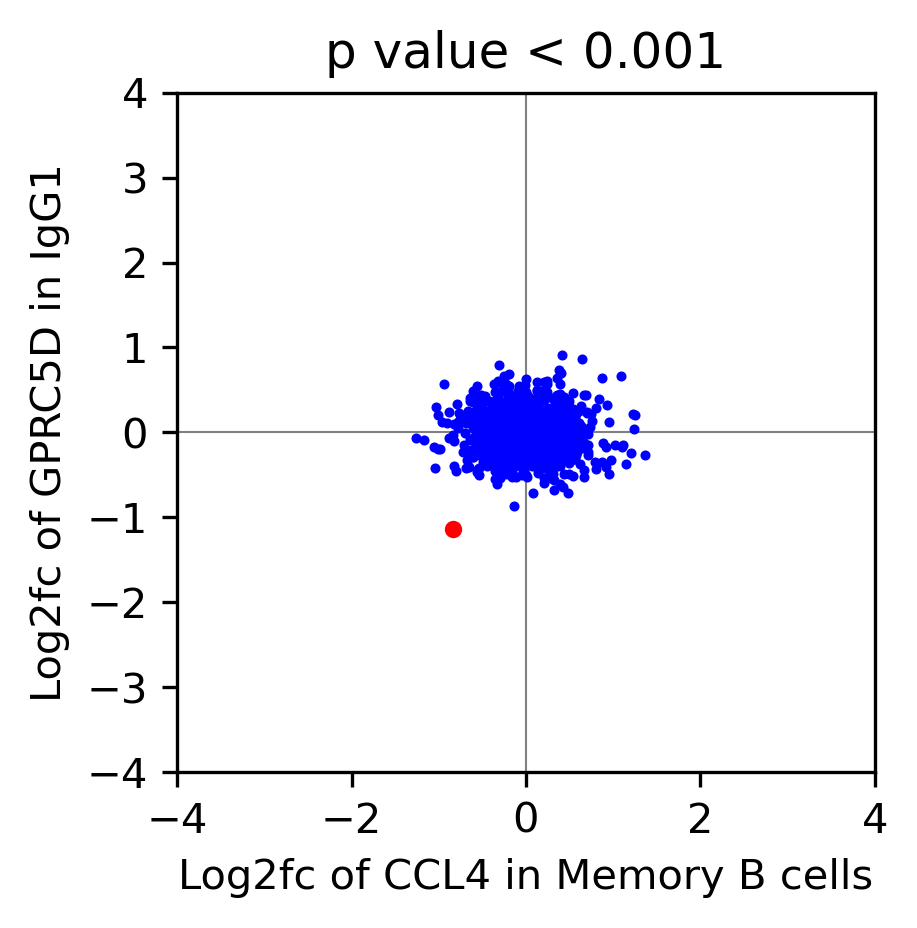

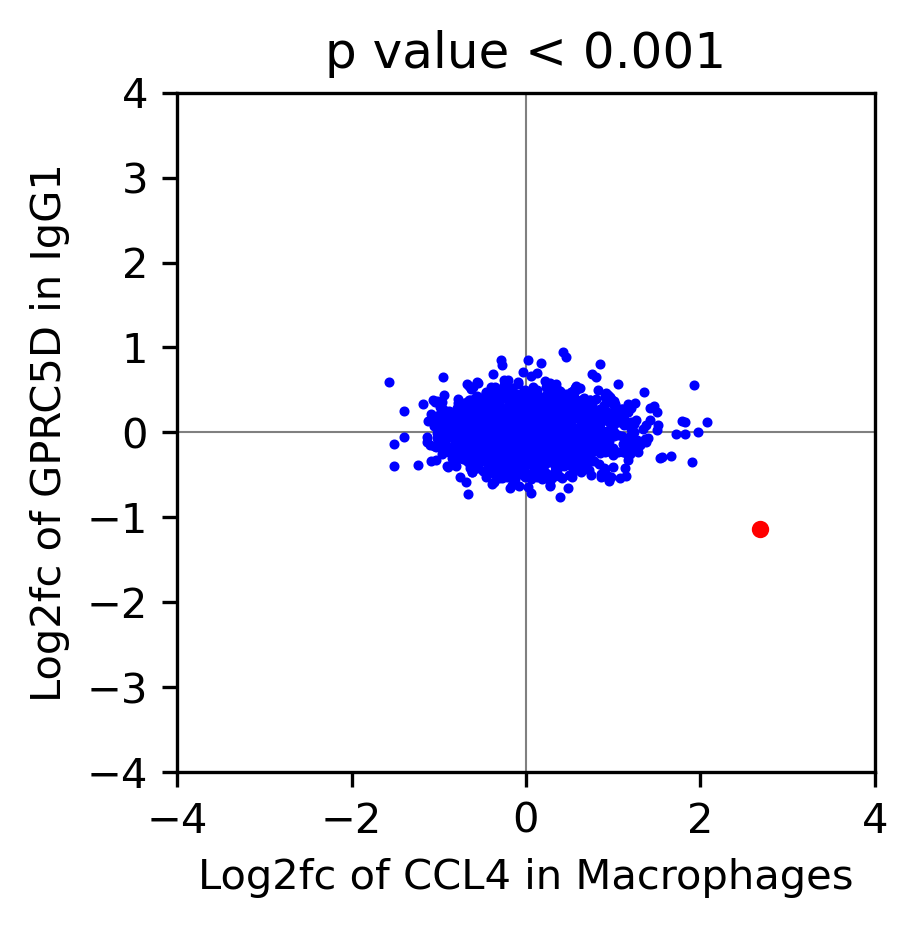

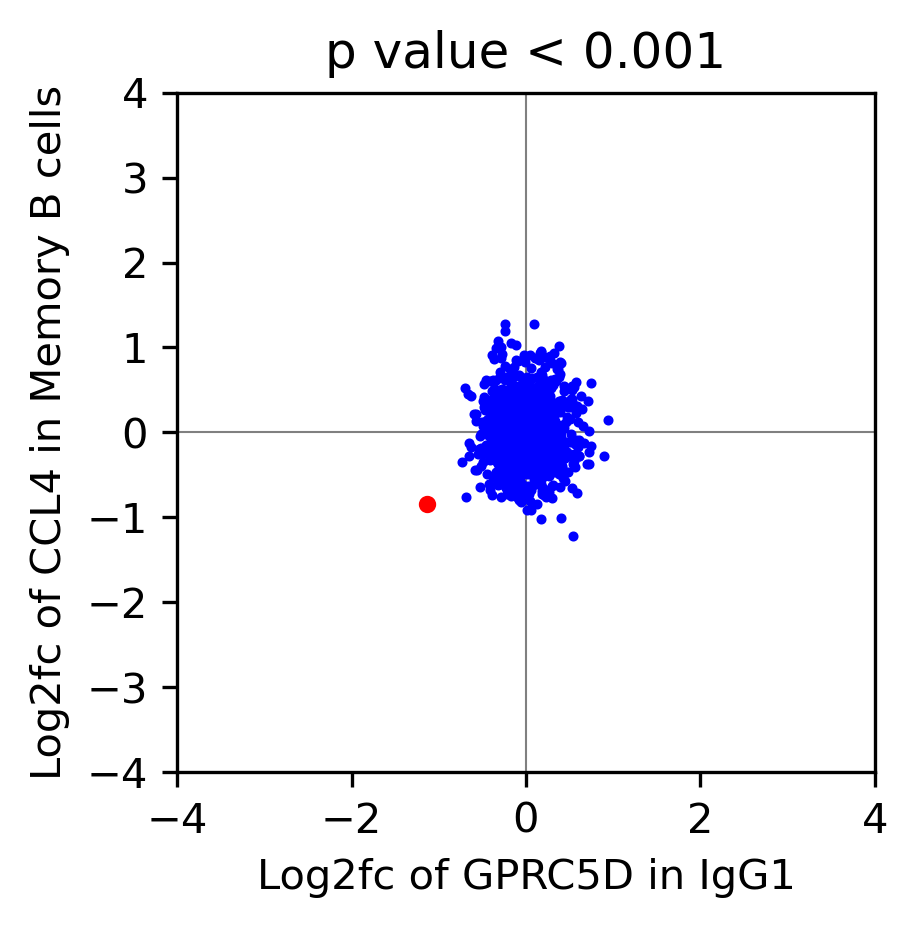

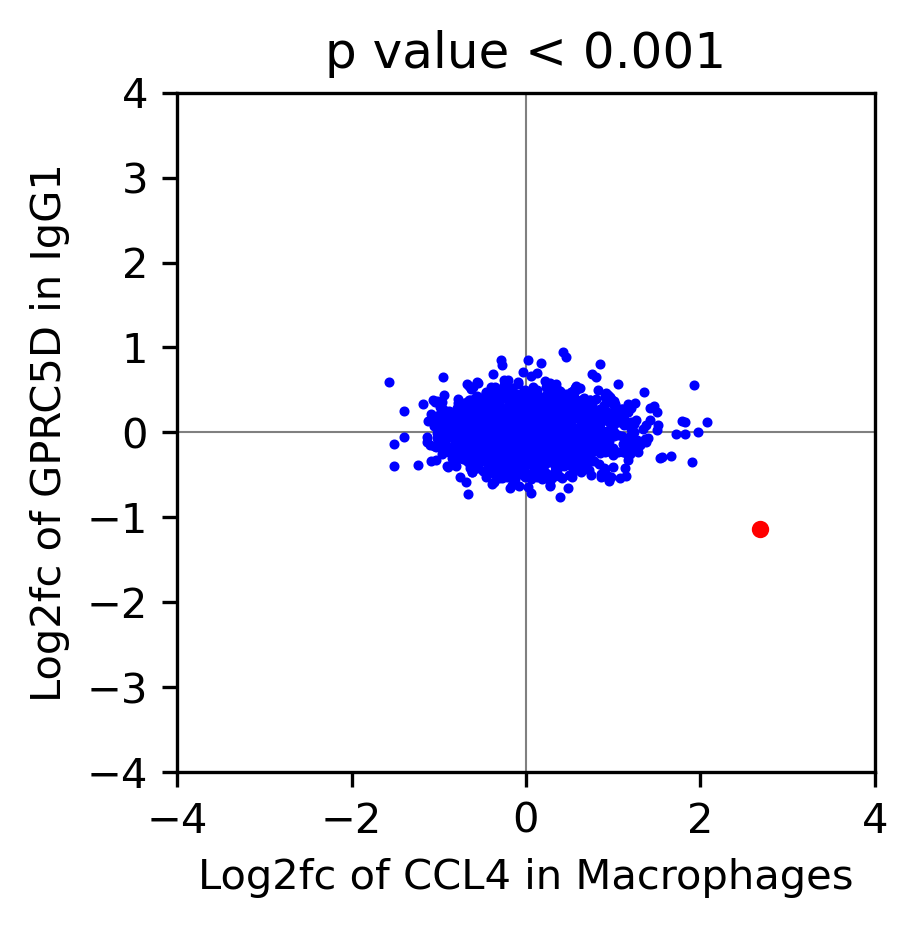

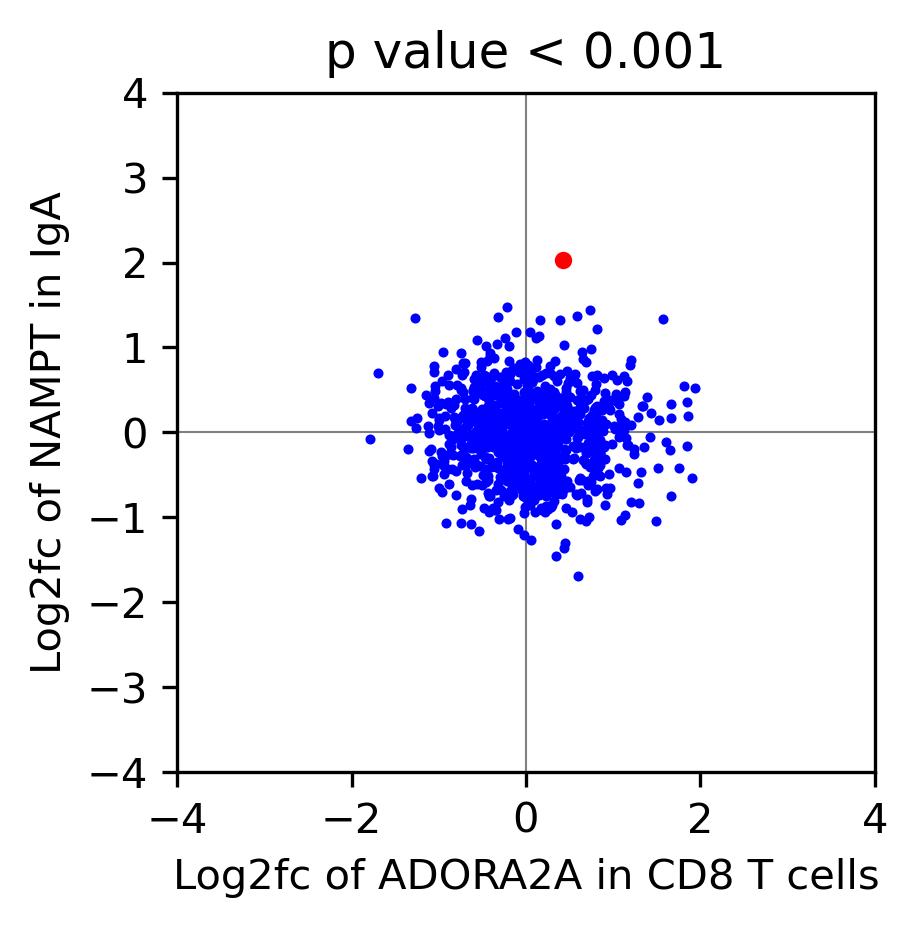

...

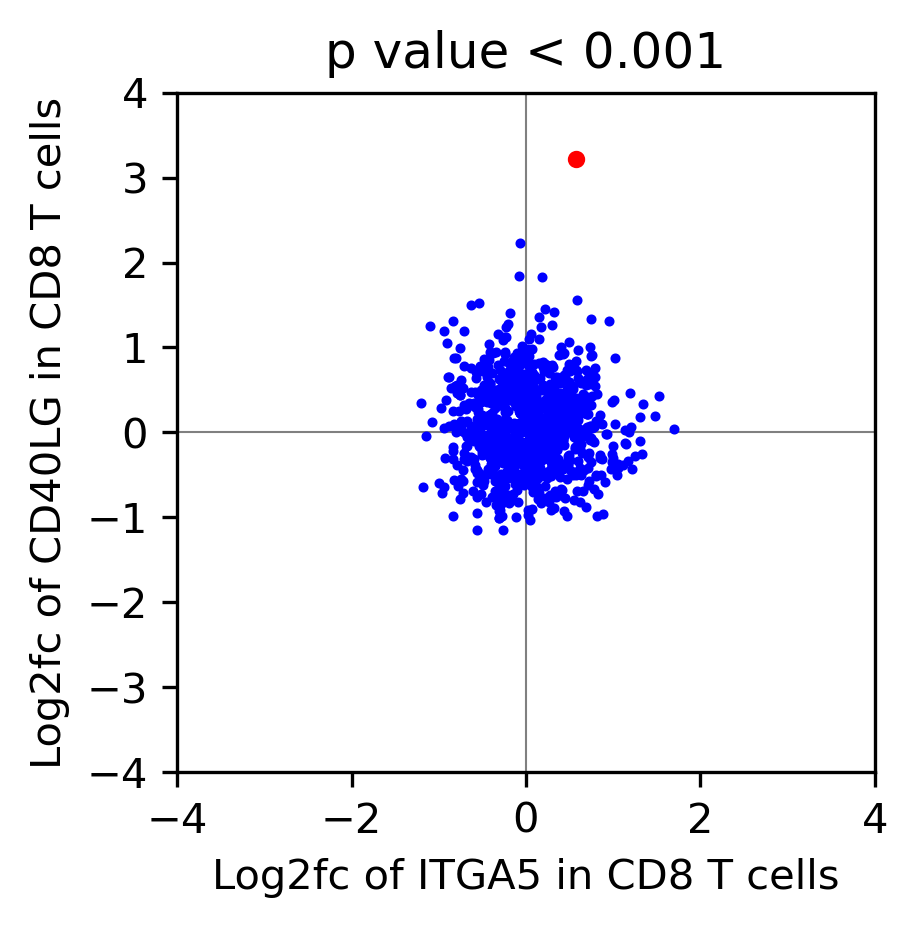

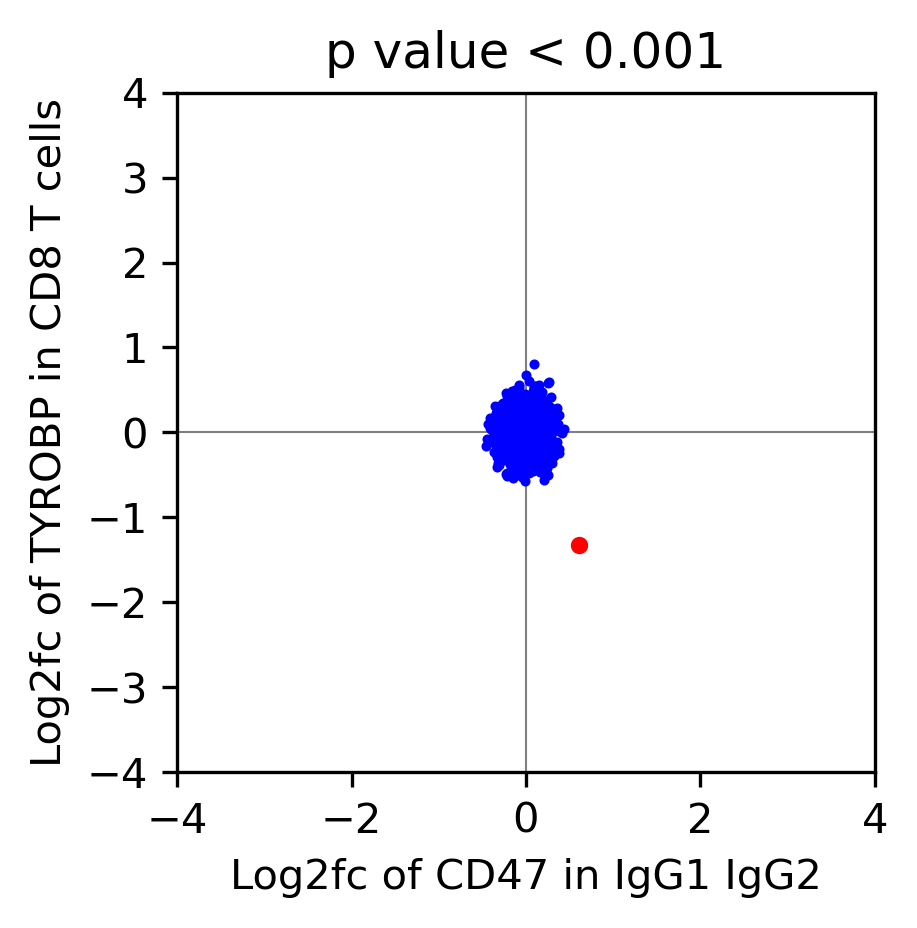

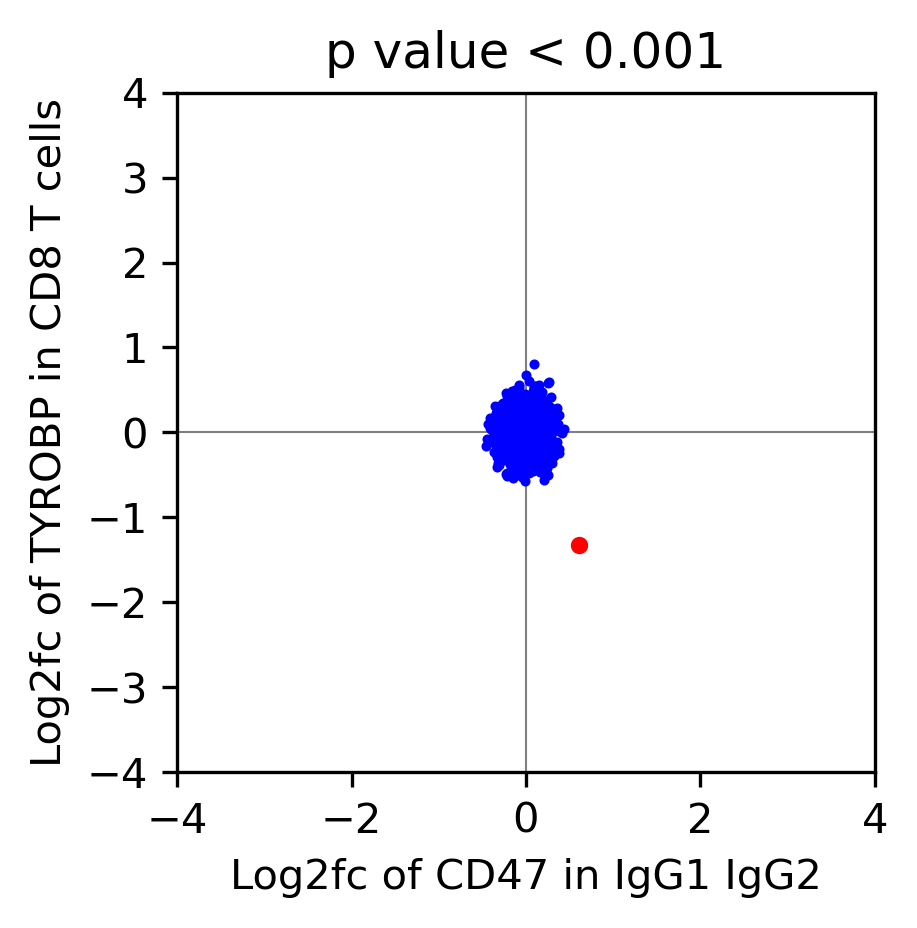

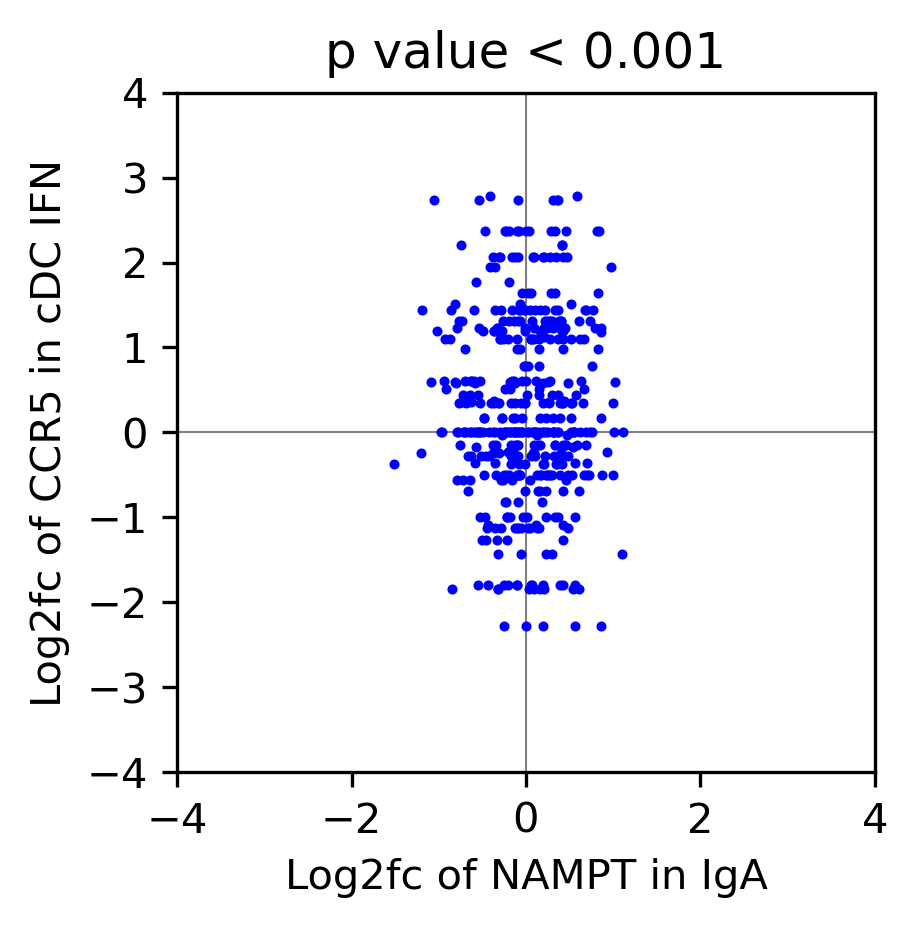

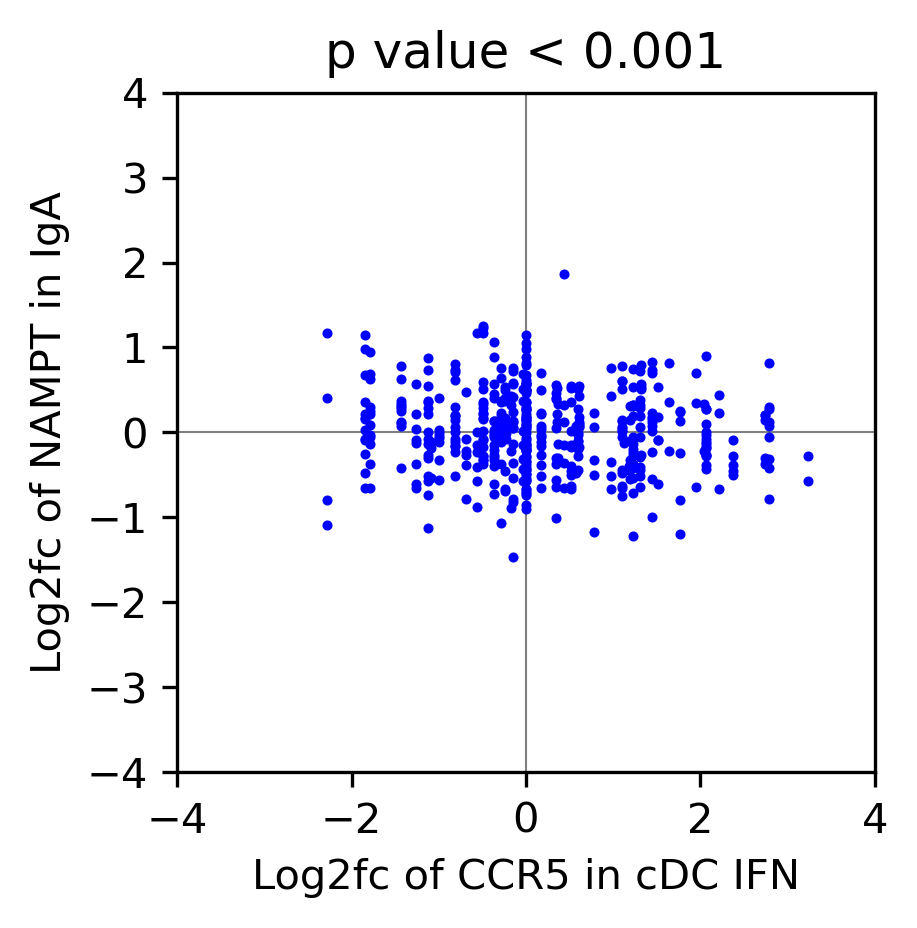

In [276]:
fdn = '/home/yike/phd/dengue/figures/cell_subtype/ran_cts/'
randomization_plot(fdn, ran_filter, ran_res)

In [75]:
ran_inters = ran_inters.reset_index()
ran_inters.set_index('inter_type', inplace=True)

up_inters = ran_inters.loc['up']
down_inters = ran_inters.loc['down']
mix_inters = ran_inters.loc['mix']
#############################################
def genes_transfer(genes):    
    new_genes = []
    for i, gene in enumerate(genes):
        new_genes.append({})
        for g, cst in zip([gene['ga'], gene['gb']], [gene['csta'], gene['cstb']]):
            if isinstance(cst, list):
                new_genes[i][g].append(cst)
            else:
                new_genes[i][g] = [cst]
                
    inters = []
    f_genes = []
    for inter in new_genes:
        it = list(inter.keys())
        if it not in inters:
            inters.append(it)
            f_genes.append(inter)
        else:
            for j, itj in enumerate(inters):
                if it == itj:
                    if inter[it[0]][0] not in f_genes[j][it[0]]:
                        f_genes[j][it[0]].append(inter[it[0]][0])
                    if inter[it[1]][0] not in f_genes[j][it[1]]:
                        f_genes[j][it[1]].append(inter[it[1]][0])            
    return f_genes
################################################
up_genes_o = [{'ga': ga, 'csta': csta, 'gb': gb, 'cstb': cstb} for ga, csta, gb, cstb in zip(up_inters['ga'].tolist(), 
                                                               up_inters['csta'].tolist(), 
                                                               up_inters['gb'].tolist(), 
                                                               up_inters['cstb'].tolist())]
down_genes_o = [{'ga': ga, 'csta': csta, 'gb': gb, 'cstb': cstb} for ga, csta, gb, cstb in zip(down_inters['ga'].tolist(), 
                                                                 down_inters['csta'].tolist(), 
                                                                 down_inters['gb'].tolist(), 
                                                                 down_inters['cstb'].tolist())]
mix_genes_o = [{'ga': ga, 'csta': csta, 'gb': gb, 'cstb': cstb} for ga, csta, gb, cstb in zip(mix_inters['ga'].tolist(), 
                                                                mix_inters['csta'].tolist(), 
                                                                mix_inters['gb'].tolist(), 
                                                                mix_inters['cstb'].tolist())]
up_genes = genes_transfer(up_genes_o)
down_genes = genes_transfer(down_genes_o)
mix_genes = genes_transfer(mix_genes_o)

mushroom_genes = up_genes + down_genes + mix_genes

In [298]:
ran_inters

ga_med_pair  \
ga        csta           gb      cstb                                   
CCL4      Macrophages    GPRC5D  IgG1                        1.021308   
GPRC5D    IgG1           CCL4    Memory_B_cells             -1.149782   
TNFRSF10A Memory_B_cells TNFSF10 Macrophages                 1.184086   
                                 non_classical_monocytes     1.184086   
                                 pDCs                        1.184086   
...                                                               ...   
ITGB1     cDC2           CD40LG  CD8_T_cells                 1.314642   
CD40LG    CD8_T_cells    ITGA5   CD8_T_cells                 3.706979   
ITGA5     CD8_T_cells    CD40LG  CD8_T_cells                 1.740496   
CD47      IgG1_IgG2      TYROBP  CD8_T_cells                 1.098676   
CCR5      cDC_IFN        NAMPT   IgA                         9.596258   

                                                          ga_fra_pair  \
ga        csta           gb      cstb                                   
CCL4      Macrophages    GPRC5D  IgG1                        0.607143   
GPRC5D    IgG1           CCL4    Memory_B_cells              0.214286   
TNFRSF10A Memory_B_cells TNFSF10 Macrophages                 0.937500   
                                 non_classical_monocytes     0.937500   
                                 pDCs                        0.937500   
...                                                               ...   
ITGB1     cDC2           CD40LG  CD8_T_cells                 1.000000   
CD40LG    CD8_T_cells    ITGA5   CD8_T_cells                 0.875000   
ITGA5     CD8_T_cells    CD40LG  CD8_T_cells                 0.750000   
CD47      IgG1_IgG2      TYROBP  CD8_T_cells                 0.892857   
CCR5      cDC_IFN        NAMPT   IgA                         0.666667   

                                                          ga_SD_fra  ga_D_fra  \
ga        csta           gb      cstb                                           
CCL4      Macrophages    GPRC5D  IgG1                      0.436508  0.126984   
GPRC5D    IgG1           CCL4    Memory_B_cells            0.108204  0.182342   
TNFRSF10A Memory_B_cells TNFSF10 Macrophages               0.069981  0.036638   
                                 non_classical_monocytes   0.069981  0.036638   
                                 pDCs                      0.069981  0.036638   
...                                                             ...       ...   
ITGB1     cDC2           CD40LG  CD8_T_cells               0.523490  0.179487   
CD40LG    CD8_T_cells    ITGA5   CD8_T_cells               0.035952  0.004598   
ITGA5     CD8_T_cells    CD40LG  CD8_T_cells               0.027297  0.014943   
CD47      IgG1_IgG2      TYROBP  CD8_T_cells               0.294400  0.229526   
CCR5      cDC_IFN        NAMPT   IgA                       0.125000  0.000000   

                                                          gb_med_pair  \
ga        csta           gb      cstb                                   
CCL4      Macrophages    GPRC5D  IgG1                       -1.149782   
GPRC5D    IgG1           CCL4    Memory_B_cells             -1.421546   
TNFRSF10A Memory_B_cells TNFSF10 Macrophages                -1.427826   
                                 non_classical_monocytes    -1.128998   
                                 pDCs                       -2.631928   
...                                                               ...   
ITGB1     cDC2           CD40LG  CD8_T_cells                 3.706979   
CD40LG    CD8_T_cells    ITGA5   CD8_T_cells                 1.740496   
ITGA5     CD8_T_cells    CD40LG  CD8_T_cells                 3.706979   
CD47      IgG1_IgG2      TYROBP  CD8_T_cells                -1.250729   
CCR5      cDC_IFN        NAMPT   IgA                         2.541867   

                                                          gb_fra_pair  \
ga        csta           gb      cstb                                   
CCL4    

In [301]:
ran_inters = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/pair_filter_inters_cst_nsem.tsv', sep='\t')
up_inters = ran_inters[ran_inters['inter_type'] == 'up']
down_inters = ran_inters[ran_inters['inter_type'] == 'down']
mix_inters = ran_inters[ran_inters['inter_type'] == 'mix']

In [302]:
up_g = [(ga, csta, gb, cstb) for ga, csta, gb, cstb in zip(up_inters['ga'].tolist(), 
                                                               up_inters['csta'].tolist(), 
                                                               up_inters['gb'].tolist(), 
                                                               up_inters['cstb'].tolist())]
down_g = [(ga, csta, gb, cstb) for ga, csta, gb, cstb in zip(down_inters['ga'].tolist(), 
                                                                 down_inters['csta'].tolist(), 
                                                                 down_inters['gb'].tolist(), 
                                                                 down_inters['cstb'].tolist())]
mix_g = [(ga, csta, gb, cstb) for ga, csta, gb, cstb in zip(mix_inters['ga'].tolist(), 
                                                                mix_inters['csta'].tolist(), 
                                                                mix_inters['gb'].tolist(), 
                                                                mix_inters['cstb'].tolist())]
csts_inters = up_g + down_g + mix_g

cts_inters = [('ITGAX', 'B_cells', 'ICAM1', 'Plasmablasts'),
             ('ENTPD1', 'NK_cells', 'ADORA2A', 'Plasmablasts'),
             ('ITGAX', 'NK_cells', 'ICAM1', 'Plasmablasts'),
             ('ICAM1', 'Plasmablasts', 'ITGB2', 'cDCs'),
             ('CTLA4', 'T_cells', 'CD86', 'T_cells'),
             ('IL6', 'Monocytes', 'IL6ST', 'Plasmablasts'),
             ('CCL4L2', 'T_cells', 'VSIR', 'pDCs'),
             ('CCL4L2', 'Monocytes', 'VSIR', 'pDCs'),
             ('KLRF1', 'Monocytes', 'CLEC2B', 'Plasmablasts'),
             ('CXCR2', 'Monocytes', 'PPBP', 'Plasmablasts'),
             ('CLEC2B', 'Plasmablasts', 'KLRF1', 'Plasmablasts'),
             ('LTBR', 'cDCs', 'LTB', 'Plasmablasts'),
             ('CXCR3', 'Plasmablasts', 'CXCL10', 'Monocytes'),
             ('CCR2', 'Plasmablasts', 'CCL2', 'Monocytes'),
             ('CCR5', 'T_cells', 'CCL4', 'B_cells'),
             ('RETN', 'Monocytes', 'GPR25', 'Plasmablasts'),
             ('DPP4', 'pDCs', 'CXCL10', 'Monocytes'),
             ('SLC1A5', 'T_cells', 'LGALS9', 'Plasmablasts'),
             ('CCL4L2', 'Monocytes', 'FFAR2', 'Monocytes'),
             ('CCL4L2', 'T_cells', 'FFAR2', 'Monocytes'),
             ('BAG6', 'cDCs', 'NCR3', 'Plasmablasts'),
             ('CXCL8', 'Monocytes', 'CXCR2', 'Monocytes'),
             ('CCR2', 'Plasmablasts', 'CCL8', 'Monocytes'),
             ('CCR5', 'T_cells', 'CCL8', 'Monocytes'),
             ('HAVCR2', 'T_cells', 'LGALS9', 'Plasmablasts'),
             ('ITGAX', 'B_cells', 'FCER2', 'Plasmablasts'),
             ('ITGAX', 'NK_cells', 'FCER2', 'Plasmablasts'),
             ('ITGB2', 'cDCs', 'FCER2', 'Plasmablasts')]

In [303]:
cts_its = [(inter[0], inter[2]) for inter in cts_inters]
csts_its = [(inter[0], inter[2]) for inter in csts_inters]

csts_in = [inter for inter in csts_inters if ((inter[0], inter[2]) in cts_its) | ((inter[2], inter[0]) in cts_its)]
csts_out = [inter for inter in csts_inters if ((inter[0], inter[2]) not in cts_its) & ((inter[2], inter[0]) not in cts_its)]

In [338]:
ct_cst = {
    'Monocytes': ['Classical_monocytes',  'Macrophages', 'non_classical_monocytes'],
    'Plasmablasts': ['IgA', 'IgG1_proliferate', 'IgG1', 'IgM', 'IgG1_IgG2'],
    'B_cells': ['Naive_B_cells',  'Memory_B_cells'],
    'T_cells': [ 'CD4_T_cells', 'CD8_T_cells'],
    'NK_cells': ['NK',  'NKT'],
    'cDCs': ['cDC_IFN', 'cDC2', 'cDC1'],
    'pDCs': ['pDCs']
}
# adata_children.obs[['cell_type', 'cell_subtype_2']].value_counts()

In [347]:
cst_in = []
cst_out = []

for inter in csts_inters:
    for key in ct_cst.keys():
        if inter[1] in ct_cst[key]:
            ct1 = key
        if inter[3] in ct_cst[key]:
            ct2 = key
    interi = (inter[0], ct1, inter[2], ct2)
    interj = ( inter[2], ct2, inter[0], ct1)
    
    if (interi in cts_inters) | (interj in cts_inters):
        cst_in.append(inter)
    else:
        cst_out.append(inter)


In [348]:
########get interactions with same genes and coresponding cell subtypes as significant cts-inters
in_inter = res.loc[cst_in]
in_inter.drop('Unnamed: 0', axis=1, inplace=True)
in_inter = in_inter[~in_inter.duplicated()]
in_inter.drop(('CTLA4', 'CD8_T_cells', 'CD86', 'CD8_T_cells'), axis=0, inplace=True)
in_inter.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/cst_inters_in_cts_strict.tsv', sep='\t')

out_inter = res.loc[cst_out]
out_inter.drop('Unnamed: 0', axis=1, inplace=True)
out_inter = out_inter[~out_inter.duplicated()]
out_inter.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/cst_inters_out_cts_strict.tsv', sep='\t')

In [351]:
in_inter

ga_med_pair  \
ga      csta                gb     cstb                                   
ADORA2A IgM                 ENTPD1 NK                          2.612373   
CD86    CD8_T_cells         CTLA4  CD8_T_cells                 3.622499   
CCL4L2  Classical_monocytes VSIR   pDCs                        1.235812   
ICAM1   IgG1_proliferate    ITGAX  NKT                         2.342427   
        IgG1                ITGAX  NKT                         3.199701   
ITGB2   cDC_IFN             ICAM1  IgG1_proliferate            1.967937   
ICAM1   IgG1                ITGB2  cDC_IFN                     3.199701   
CXCR3   IgA                 CXCL10 Macrophages                 1.058357   
        IgG1_proliferate    CXCL10 Macrophages                 1.106691   
        IgG1_IgG2           CXCL10 Macrophages                 2.302328   
        IgG1                CXCL10 Macrophages                 1.178789   
        IgA                 CXCL10 non_classical_monocytes     1.058357   
        IgG1_proliferate    CXCL10 non_classical_monocytes     1.106691   
        IgG1_IgG2           CXCL10 non_classical_monocytes     2.302328   
        IgG1                CXCL10 non_classical_monocytes     1.178789   
        IgA                 CXCL10 Classical_monocytes         1.058357   
        IgG1_proliferate    CXCL10 Classical_monocytes         1.106691   
        IgG1_IgG2           CXCL10 Classical_monocytes         2.302328   
        IgG1                CXCL10 Classical_monocytes         1.178789   
CCR2    IgA                 CCL2   Classical_monocytes         1.482665   
        IgG1_proliferate    CCL2   Classical_monocytes         1.868322   
        IgG1                CCL2   Classical_monocytes         1.424078   
RETN    Classical_monocytes GPR25  IgG1_proliferate            1.621244   
                                   IgG1                        1.621244   
DPP4    pDCs                CXCL10 Macrophages                 2.703851   
                                   Classical_monocytes         2.703851   
CCL4L2  Classical_monocytes FFAR2  Macrophages                 1.235812   
CCR2    IgA                 CCL8   Classical_monocytes         1.482665   
        IgG1_proliferate    CCL8   Classical_monocytes         1.868322   
        IgG1                CCL8   Classical_monocytes         1.424078   
ITGAX   NK                  FCER2  IgG1_IgG2                   1.147144   
        NKT                 FCER2  IgG1_IgG2                   1.681081   
ITGB2   cDC_IFN             FCER2  IgG1_IgG2                   1.967937   

                                                            ga_fra_pair  \
ga      csta                gb     cstb                                   
ADORA2A IgM                 ENTPD1 NK                          0.809524   
CD86    CD8_T_cells         CTLA4  CD8_T_cells                 0.875000   
CCL4L2  Classical_monocytes VSIR   pDCs                        0.593750   
ICAM1   IgG1_proliferate    ITGAX  NKT                         0.937500   
        IgG1                ITGAX  NKT                         0.714286   
ITGB2   cDC_IFN             ICAM1  IgG1_proliferate            1.000000   
ICAM1   IgG1                ITGB2  cDC_IFN                     0.714286   
CXCR3   IgA                 CXCL10 Macrophages                 0.781250   
        IgG1_proliferate    CXCL10 Macrophages                 0.781250   
        IgG1_IgG2           CXCL10 Macrophages                 0.714286   
        IgG1                CXCL10 Macrophages                 0.785714   
        IgA                 CXCL10 non_classical_monocytes     0.781250   
        IgG1_proliferate    CXCL10 non_classical_monocytes     0.781250   
        IgG1_IgG2           CXCL10 non_classical_monocytes     0.714286   
        IgG1                CXCL10 non_classical_monocytes     0.785714   
        IgA                 CXCL10 Classical_monocytes         0.781250   
        IgG1_proliferate    CXCL10 Classical_monocytes         0.781250   
        I

<ipython-input-52-72342df8cc4b>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'fig': <Figure size 468x6660 with 12 Axes>,
 'ax': [<AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>]}

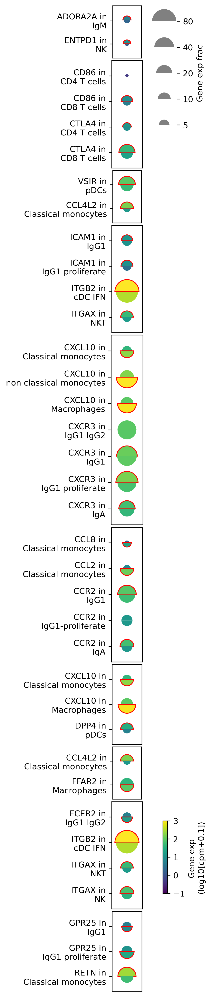

In [57]:
in_inter_genes = [
    {'ENTPD1': ['NK'], 'ADORA2A': ['IgM'], },
    {'CTLA4': ['CD8_T_cells', 'CD4_T_cells'], 'CD86': ['CD8_T_cells', 'CD4_T_cells']},
    {'CCL4L2': ['Classical_monocytes'], 'VSIR': ['pDCs']},
    {'ITGAX': ['NKT'], 'ITGB2': ['cDC_IFN'], 'ICAM1': ['IgG1_proliferate', 'IgG1']},
    {'CXCR3': ['IgA', 'IgG1_proliferate', 'IgG1', 'IgG1_IgG2'],
    'CXCL10': ['Macrophages', 'non_classical_monocytes', 'Classical_monocytes']},
    {'CCR2': ['IgA', 'IgG1-proliferate', 'IgG1'] , 
    'CCL2': ['Classical_monocytes'], 
    'CCL8': ['Classical_monocytes']},
    {'DPP4': ['pDCs'], 'CXCL10': ['Macrophages', 'Classical_monocytes']},
    {'FFAR2': ['Macrophages'], 'CCL4L2': ['Classical_monocytes']},
    {'ITGAX': ['NK', 'NKT'], 'ITGB2': ['cDC_IFN'], 'FCER2': ['IgG1_IgG2']},
    {'RETN': ['Classical_monocytes'], 'GPR25': ['IgG1_proliferate', 'IgG1']}
    ]

s_mushrooms(in_inter_genes)

In [48]:
data = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/data_pair.tsv', sep='\t', index_col=[ 'gene', 'cell_subtype_2'])

<ipython-input-365-c74dafd5a61a>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'fig': <Figure size 468x1620 with 3 Axes>, 'ax': [<AxesSubplot:>]}

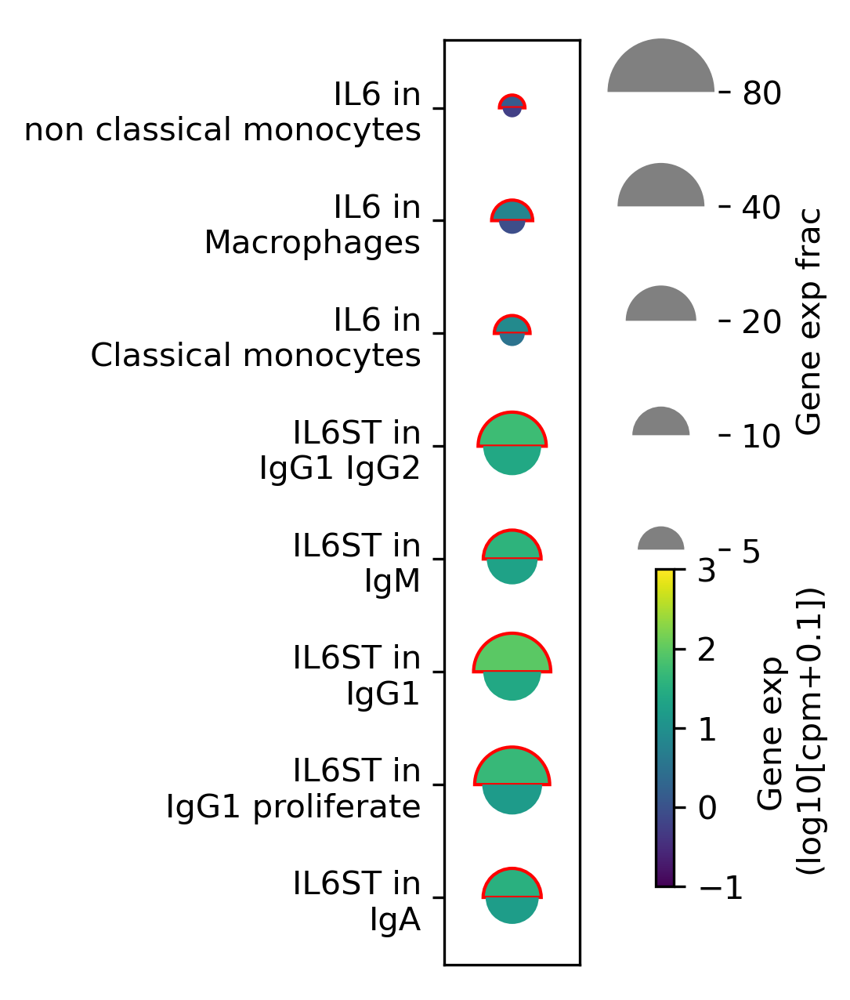

In [378]:
s_mushrooms([
    {'IL6ST': ['IgA', 'IgG1_proliferate', 'IgG1', 'IgM', 'IgG1_IgG2'],
    'IL6': ['Classical_monocytes',  'Macrophages', 'non_classical_monocytes']}
])

In [398]:
# adata_Mo = adata_children[(adata_children.obs['cell_type'] == 'Monocytes') & (adata_children.obs['Condition'].isin(['S_dengue', 'dengue']))]
# IL6 = adata_Mo[:, 'IL6'][adata_Mo[:, 'IL6'].X > 0]
# IL6.obs[['ID', 'cell_subtype_2', 'Condition']].groupby(['ID', 'cell_subtype_2', 'Condition']).size().unstack()

In [407]:
out_up = out_inter[out_inter['inter_type'] == 'up']
out_down = out_inter[out_inter['inter_type'] == 'down']
out_mix = out_inter[out_inter['inter_type'] == 'mix']

In [414]:
out_up[(out_up['ga_fra_pair'] > 0.8) & (out_up['gb_fra_pair'] > 0.8)]

ga_med_pair  ga_fra_pair  \
ga       csta        gb      cstb                                         
ENTPD1   cDC1        ADORA2A IgM                  8.114679     1.000000   
FAM3C    IgG1_IgG2   LAMP1   IgA                  1.674706     0.821429   
                             IgG1_proliferate     1.674706     0.821429   
LAMP1    IgG1        FAM3C   IgG1_IgG2            1.780175     1.000000   
CADM1    IgA         CADM1   IgA                  1.653297     0.843750   
TNFRSF1B IgG1        TNF     Macrophages          3.455887     0.857143   
LGALS9   cDC1        SLC1A5  NKT                  1.296324     1.000000   
BMP8B    IgG1        PLAUR   cDC2                 4.919275     1.000000   
IL12A    IgG1_IgG2   IL12RB2 CD8_T_cells          3.787441     0.857143   
         IgG1        IL12RB2 CD8_T_cells          3.207072     0.857143   
IL6ST    cDC1        EBI3    IgG1_proliferate     8.491396     1.000000   
IL12A    IgG1_IgG2   IL6ST   IgG1_proliferate     3.787441     0.857143   
         IgG1        IL6ST   IgG1_proliferate     3.207072     0.857143   
IL6ST    cDC1        IL12A   IgG1_IgG2            8.491396     1.000000   
IL10     CD8_T_cells IL10RA  Naive_B_cells        4.605818     0.843750   
IL10RB   Macrophages IL10    CD8_T_cells          1.475856     0.821429   
         cDC2        IL10    CD8_T_cells          1.813267     1.000000   
OSM      cDC2        IL6ST   IgG1_proliferate     7.430244     1.000000   
                             IgG1_IgG2            7.430244     1.000000   
IL6ST    cDC1        OSM     cDC2                 8.491396     1.000000   
ITGB1    cDC2        CD40LG  CD8_T_cells          1.314642     1.000000   

                                               ga_SD_fra  ga_D_fra  \
ga       csta        gb      cstb                                    
ENTPD1   cDC1        ADORA2A IgM                0.307692  0.000000   
FAM3C    IgG1_IgG2   LAMP1   IgA                0.302400  0.294181   
                             IgG1_proliferate   0.302400  0.294181   
LAMP1    IgG1        FAM3C   IgG1_IgG2          0.206208  0.061420   
CADM1    IgA         CADM1   IgA                0.126338  0.049140   
TNFRSF1B IgG1        TNF     Macrophages        0.034590  0.003839   
LGALS9   cDC1        SLC1A5  NKT                0.897436  0.466667   
BMP8B    IgG1        PLAUR   cDC2               0.023503  0.001919   
IL12A    IgG1_IgG2   IL12RB2 CD8_T_cells        0.036800  0.025862   
         IgG1        IL12RB2 CD8_T_cells        0.061197  0.049904   
IL6ST    cDC1        EBI3    IgG1_proliferate   0.307692  0.133333   
IL12A    IgG1_IgG2   IL6ST   IgG1_proliferate   0.036800  0.025862   
         IgG1        IL6ST   IgG1_proliferate   0.061197  0.049904   
IL6ST    cDC1        IL12A   IgG1_IgG2          0.307692  0.133333   
IL10     CD8_T_cells IL10RA  Naive_B_cells      0.021638  0.001149   
IL10RB   Macrophages IL10    CD8_T_cells        0.174603  0.087302   
         cDC2        IL10    CD8_T_cells        0.221477  0.076923   
OSM      cDC2        IL6ST   IgG1_proliferate   0.073826  0.000000   
                             IgG1_IgG2          0.073826  0.000000   
IL6ST    cDC1        OSM     cDC2               0.307692  0.133333   
ITGB1    cDC2        CD40LG  CD8_T_cells        0.523490  0.179487   

                                               gb_med_pair  gb_fra_pair  \
ga       csta        gb      cstb                                         
ENTPD1   cDC1        ADORA2A IgM                  2.612373     0.809524   
FAM3C    IgG1_IgG2   LAMP1   IgA                  2.335410     0.937500   
                             IgG1_proliferate     1.332536     0.968750   
LAMP1    IgG1        FAM3C   IgG1_IgG2            1.674706     0.821429   
CADM1    IgA         CADM1   IgA                  1.653297     0.843750   
TNFRSF1B IgG1        TNF     Macrophages          1.154540     0.857143   
LGALS9   cDC1        SLC1A5  NKT                  7.259750     1.000000   
BMP8B    IgG1        PLAUR   cDC2  

In [422]:
out_down[(out_down['ga_fra_pair'] < 0.2) & (out_down['gb_fra_pair'] < 0.2)]

,,,,ga_med_pair,ga_fra_pair,ga_SD_fra,ga_D_fra,gb_med_pair,gb_fra_pair,gb_SD_fra,gb_D_fra,inter_type
ga,csta,gb,cstb,,,,,,,,,
CCL8,Classical_monocytes,CCR5,pDCs,-4.680548,0.0625,0.002861,0.026107,-3.773626,0.000000,0.000000,0.025806,down
IL2RG,Classical_monocytes,IL15,non_classical_monocytes,-1.430654,0.1875,0.043090,0.062429,-1.981248,0.142857,0.104895,0.103175,down


In [424]:
out_mix[(out_mix['ga_fra_pair'] > 0.8) & (out_mix['gb_fra_pair'] < 0.2)]

ga_med_pair  \
ga        csta                gb      cstb                                   
TNFRSF10A Memory_B_cells      TNFSF10 Macrophages                 1.184086   
                                      non_classical_monocytes     1.184086   
                                      pDCs                        1.184086   
                                      Classical_monocytes         1.184086   
ENTPD1    NK                  ADORA2B cDC_IFN                     2.240869   
CD40LG    CD8_T_cells         CD40    IgG1_IgG2                   3.706979   
GAS6      IgG1_proliferate    TYRO3   cDC2                        2.096345   
          IgG1                TYRO3   cDC2                        1.950569   
ICAM1     IgG1_proliferate    SPN     Macrophages                 2.342427   
CCR2      IgG1_proliferate    CCL2    cDC2                        1.868322   
          IgG1                CCL2    cDC2                        1.424078   
RETN      Classical_monocytes GPR25   NKT                         1.621244   
SLC1A5    NKT                 LGALS9  IgG1_proliferate            7.259750   
                                      IgM                         7.259750   
          IgA                 LGALS9  IgG1_proliferate            1.069065   
NETO2     CD8_T_cells         NRG1    cDC2                        4.407555   
IL6ST     IgG1_proliferate    OSM     Classical_monocytes         1.676319   
OSM       cDC2                IL6ST   cDC_IFN                     7.430244   
IL6ST     IgG1_IgG2           OSM     Classical_monocytes         3.181730   
ITGB1     cDC2                COL7A1  cDC2                        1.314642   
CD47      IgG1_IgG2           TYROBP  CD8_T_cells                 1.098676   

                                                               ga_fra_pair  \
ga        csta                gb      cstb                                   
TNFRSF10A Memory_B_cells      TNFSF10 Macrophages                 0.937500   
                                      non_classical_monocytes     0.937500   
                                      pDCs                        0.937500   
                                      Classical_monocytes         0.937500   
ENTPD1    NK                  ADORA2B cDC_IFN                     1.000000   
CD40LG    CD8_T_cells         CD40    IgG1_IgG2                   0.875000   
GAS6      IgG1_proliferate    TYRO3   cDC2                        0.906250   
          IgG1                TYRO3   cDC2                        1.000000   
ICAM1     IgG1_proliferate    SPN     Macrophages                 0.937500   
CCR2      IgG1_proliferate    CCL2    cDC2                        0.875000   
          IgG1                CCL2    cDC2                        0.928571   
RETN      Classical_monocytes GPR25   NKT                         0.937500   
SLC1A5    NKT                 LGALS9  IgG1_proliferate            1.000000   
                                      IgM                         1.000000   
          IgA                 LGALS9  IgG1_proliferate            0.812500   
NETO2     CD8_T_cells         NRG1    cDC2                        0.968750   
IL6ST     IgG1_proliferate    OSM     Classical_monocytes         0.906250   
OSM       cDC2                IL6ST   cDC_IFN                     1.000000   
IL6ST     IgG1_IgG2           OSM     Classical_monocytes         0.821429   
ITGB1     cDC2                COL7A1  cDC2                        1.000000   
CD47      IgG1_IgG2           TYROBP  CD8_T_cells                 0.892857   

                                                               ga_SD_fra  \
ga        csta                gb      cstb                                 
TNFRSF10A Memory_B_cells      TNFSF10 Macrophages               0.069981   
                                      non_classical_monocytes   0.069981   
                                      pDCs                      0.069981   
                                      Classical_monocytes       0.069981   
ENTPD1    NK     

<ipython-input-52-72342df8cc4b>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'fig': <Figure size 468x2880 with 7 Axes>,
 'ax': [<AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>]}

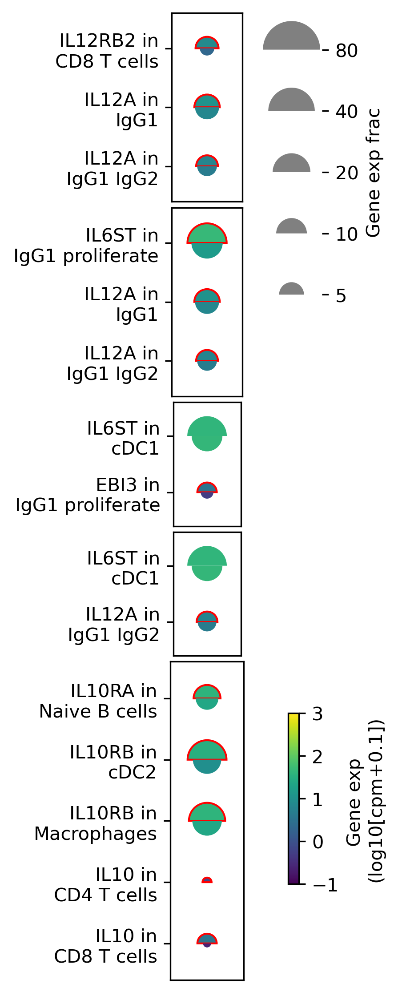

In [56]:
out_inter_genes = [
    #{'FAM3C': ['IgG1_IgG2'], 'LAMP1': ['IgA', 'IgG1', 'IgG1_proliferate']},
    {'IL12A': ['IgG1_IgG2', 'IgG1'], 'IL12RB2': ['CD8_T_cells']},
    {'IL12A': ['IgG1_IgG2', 'IgG1'], 'IL6ST': ['IgG1_proliferate']},
    {'EBI3': ['IgG1_proliferate'], 'IL6ST': ['cDC1']},
    {'IL12A': ['IgG1_IgG2'], 'IL6ST': ['cDC1']},
    #{'OSM': ['cDC2'], 'IL6ST': ['IgG1_proliferate', 'IgG1_IgG2', 'cDC1']}, #OSMR and IL6ST can form heterodimers (type II receptor) which are activated by OSM 
    {'IL10': ['CD8_T_cells', 'CD4_T_cells'], 'IL10RB': ['Macrophages', 'cDC2'], 'IL10RA': ['Naive_B_cells']},
    #{'ITGB1': ['cDC2'], 'CD40LG': ['CD8_T_cells']}, #'ITGA5' is expressed in 'cDC2'
    ]

s_mushrooms(out_inter_genes)

<ipython-input-52-72342df8cc4b>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'fig': <Figure size 468x3780 with 8 Axes>,
 'ax': [<AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>,
  <AxesSubplot:>]}

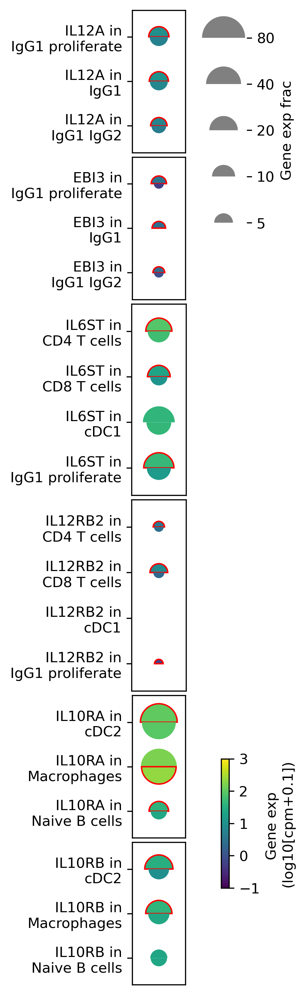

In [55]:
out_genes = [
    {'IL12A': ['IgG1_IgG2', 'IgG1', 'IgG1_proliferate']}, 
     {'EBI3': ['IgG1_IgG2', 'IgG1', 'IgG1_proliferate']},
    {'IL6ST': ['IgG1_proliferate', 'cDC1', 'CD8_T_cells', 'CD4_T_cells']}, 
     {'IL12RB2': ['IgG1_proliferate', 'cDC1', 'CD8_T_cells', 'CD4_T_cells']},
             {'IL10RA': ['Naive_B_cells', 'Macrophages',  'cDC2']},
         {'IL10RB': ['Naive_B_cells',  'Macrophages', 'cDC2']},

    ]

s_mushrooms(out_genes)

<ipython-input-471-1726df56ea8e>:10: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


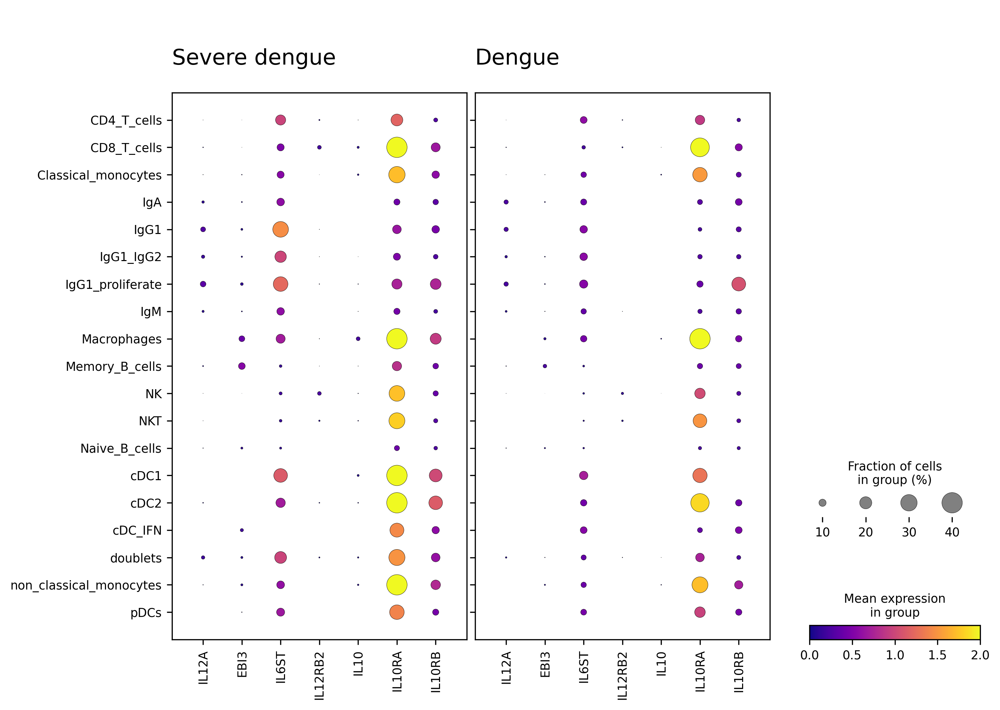

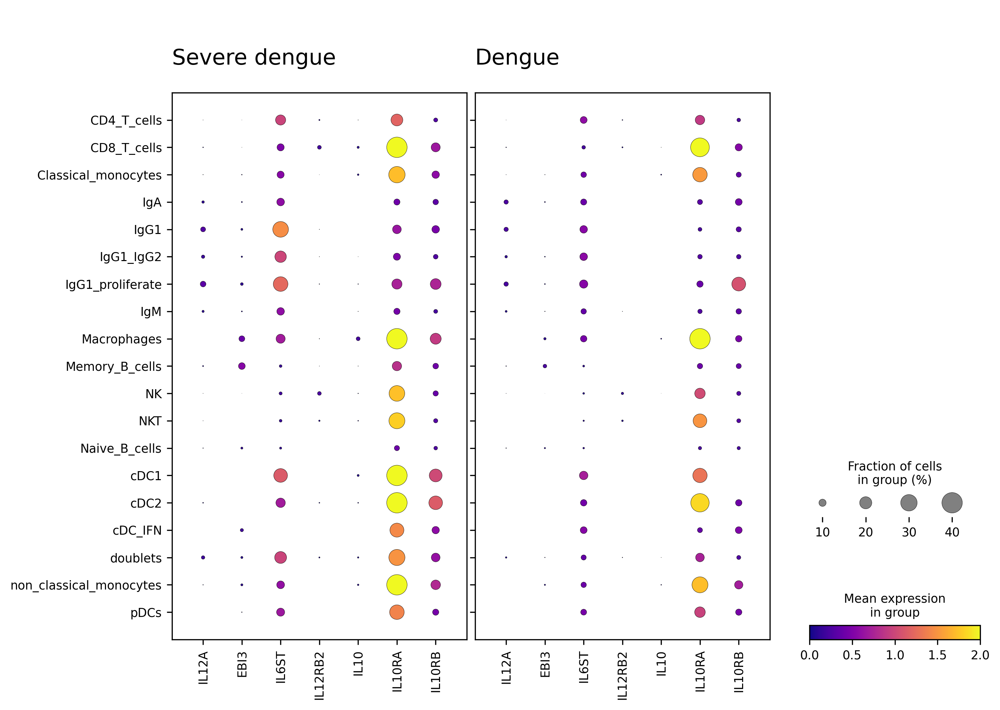

In [471]:
adata_SD = adata_children[adata_children.obs['Condition'] == 'S_dengue']
adata_D = adata_children[adata_children.obs['Condition'] == 'dengue']
sc.pp.log1p(adata_SD)
sc.pp.log1p(adata_D)

fig,axs = plt.subplots(1, 2, figsize=(10,8), gridspec_kw={'wspace':-0.4}, sharex=True, facecolor='white', dpi=300, sharey=True)
sc.pl.dotplot(adata_SD,  ['IL12A', 'EBI3', 'IL6ST','IL12RB2', 'IL10', 'IL10RA', 'IL10RB'], groupby='cell_subtype_2', ax=axs[0], show=False, cmap='plasma', vmin=0, vmax=2, dot_min=0, dot_max=0.4)
sc.pl.dotplot(adata_D,  ['IL12A', 'EBI3', 'IL6ST','IL12RB2', 'IL10', 'IL10RA', 'IL10RB'], groupby='cell_subtype_2', ax=axs[1], show=False, cmap='plasma', vmin=0, vmax=2, dot_min=0, dot_max=0.4)
axs[0].set_title('Severe dengue', fontsize=15, y=0.9, loc='left')
axs[1].set_title('Dengue', fontsize=15, y=0.9, loc='left')
axes = fig.get_axes()
axes[4].remove()
axes[5].remove()
axes[6].set_yticklabels([])
fig.tight_layout()
fig

In [320]:
########get interactions with same genes as significant cts-inters, so include inters from different cts
in_inters = res.loc[csts_in]
in_inters.drop('Unnamed: 0', axis=1, inplace=True)
in_inters = in_inters[~in_inters.duplicated()]
in_inters.drop(('CTLA4', 'CD8_T_cells', 'CD86', 'CD8_T_cells'), axis=0, inplace=True)
in_inters.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/cst_inters_in_cts.tsv', sep='\t')

out_inters = res.loc[csts_out]
out_inters.drop('Unnamed: 0', axis=1, inplace=True)
out_inters = out_inters[~out_inters.duplicated()]
out_inters.to_csv('/home/yike/phd/dengue/data/tables/cell_subtype/cst_inters_out_cts.tsv', sep='\t')
out_inters

In [323]:
in_inters[:34]

ga_med_pair  \
ga      csta                gb      cstb                                   
ADORA2A IgM                 ENTPD1  NK                          2.612373   
ENTPD1  cDC1                ADORA2A IgG1_proliferate            8.114679   
                                    IgM                         8.114679   
CD86    CD8_T_cells         CTLA4   CD8_T_cells                 3.622499   
CCR5    Macrophages         CCL4    Macrophages                 6.090720   
        cDC_IFN             CCL4    Macrophages                 9.596258   
LGALS9  cDC1                SLC1A5  NKT                         1.296324   
CCL4L2  Classical_monocytes VSIR    pDCs                        1.235812   
                                    cDC_IFN                     1.235812   
ICAM1   IgG1_proliferate    ITGAX   NKT                         2.342427   
        IgG1                ITGAX   NKT                         3.199701   
        IgG1_proliferate    ITGB2   IgA                         2.342427   
ITGB2   cDC_IFN             ICAM1   IgG1_proliferate            1.967937   
ICAM1   IgG1                ITGB2   cDC_IFN                     3.199701   
CLEC2B  IgG1_proliferate    KLRF1   CD4_T_cells                -1.329847   
        IgG1_IgG2           KLRF1   CD4_T_cells                -1.353025   
        IgG1                KLRF1   CD4_T_cells                -1.002884   
CCL8    Classical_monocytes CCR5    non_classical_monocytes    -4.680548   
                                    pDCs                       -4.680548   
CXCR3   CD8_T_cells         CXCL10  Macrophages                 1.217689   
                                    non_classical_monocytes     1.217689   
                                    Classical_monocytes         1.217689   
        IgA                 CXCL10  Macrophages                 1.058357   
        IgG1_proliferate    CXCL10  Macrophages                 1.106691   
        IgG1_IgG2           CXCL10  Macrophages                 2.302328   
        IgG1                CXCL10  Macrophages                 1.178789   
        IgA                 CXCL10  non_classical_monocytes     1.058357   
        IgG1_proliferate    CXCL10  non_classical_monocytes     1.106691   
        IgG1_IgG2           CXCL10  non_classical_monocytes     2.302328   
        IgG1                CXCL10  non_classical_monocytes     1.178789   
        IgA                 CXCL10  Classical_monocytes         1.058357   
        IgG1_proliferate    CXCL10  Classical_monocytes         1.106691   
        IgG1_IgG2           CXCL10  Classical_monocytes         2.302328   
        IgG1                CXCL10  Classical_monocytes         1.178789   

                                                             ga_fra_pair  \
ga      csta                gb      cstb                                   
ADORA2A IgM                 ENTPD1  NK                          0.809524   
ENTPD1  cDC1                ADORA2A IgG1_proliferate            1.000000   
                                    IgM                         1.000000   
CD86    CD8_T_cells         CTLA4   CD8_T_cells                 0.875000   
CCR5    Macrophages         CCL4    Macrophages                 0.535714   
        cDC_IFN             CCL4    Macrophages                 0.666667   
LGALS9  cDC1                SLC1A5  NKT                         1.000000   
CCL4L2  Classical_monocytes VSIR    pDCs                        0.593750   
                                    cDC_IFN                     0.593750   
ICAM1   IgG1_proliferate    ITGAX   NKT                         0.937500   
        IgG1                ITGAX   NKT                         0.714286   
        IgG1_proliferate    ITGB2   IgA                         0.937500   
ITGB2   cDC_IFN             ICAM1   IgG1_proliferate            1.000000   
ICAM1   IgG1                ITGB2   cDC_IFN                     0.714286   
CLEC2B  IgG1_proliferate    KLRF1   CD4_T_cells                 0.156250   
        IgG1_IgG2           KLRF

In [322]:
in_inters[34:]

ga_med_pair  \
ga     csta                gb     cstb                                   
CCR2   IgA                 CCL2   Classical_monocytes         1.482665   
                                  cDC2                        1.482665   
       IgG1_proliferate    CCL2   Classical_monocytes         1.868322   
                                  cDC2                        1.868322   
       IgG1                CCL2   Classical_monocytes         1.424078   
                                  cDC2                        1.424078   
RETN   Classical_monocytes GPR25  CD4_T_cells                 1.621244   
                                  NKT                         1.621244   
                                  IgG1_proliferate            1.621244   
                                  IgG1                        1.621244   
DPP4   CD8_T_cells         CXCL10 Macrophages                 1.240397   
                                  non_classical_monocytes     1.240397   
                                  Classical_monocytes         1.240397   
       pDCs                CXCL10 Macrophages                 2.703851   
                                  Classical_monocytes         2.703851   
SLC1A5 NKT                 LGALS9 IgA                         7.259750   
                                  IgG1_proliferate            7.259750   
                                  IgM                         7.259750   
       IgA                 LGALS9 IgG1_proliferate            1.069065   
CCL4L2 Classical_monocytes FFAR2  Macrophages                 1.235812   
CLEC2B cDC2                KLRF1  CD4_T_cells                 1.227716   
CCR2   IgA                 CCL8   Classical_monocytes         1.482665   
       IgG1_proliferate    CCL8   Classical_monocytes         1.868322   
       IgG1                CCL8   Classical_monocytes         1.424078   
CCR5   Macrophages         CCL8   Classical_monocytes         6.090720   
       cDC_IFN             CCL8   Classical_monocytes         9.596258   
ITGAX  NK                  FCER2  IgG1_IgG2                   1.147144   
       NKT                 FCER2  IgG1_IgG2                   1.681081   
ITGB2  cDC_IFN             FCER2  IgG1_IgG2                   1.967937   

                                                           ga_fra_pair  \
ga     csta                gb     cstb                                   
CCR2   IgA                 CCL2   Classical_monocytes         0.781250   
                                  cDC2                        0.781250   
       IgG1_proliferate    CCL2   Classical_monocytes         0.875000   
                                  cDC2                        0.875000   
       IgG1                CCL2   Classical_monocytes         0.928571   
                                  cDC2                        0.928571   
RETN   Classical_monocytes GPR25  CD4_T_cells                 0.937500   
                                  NKT                         0.937500   
                                  IgG1_proliferate            0.937500   
                                  IgG1                        0.937500   
DPP4   CD8_T_cells         CXCL10 Macrophages                 0.781250   
                                  non_classical_monocytes     0.781250   
                                  Classical_monocytes         0.781250   
       pDCs                CXCL10 Macrophages                 0.843750   
                                  Classical_monocytes         0.843750   
SLC1A5 NKT                 LGALS9 IgA                         1.000000   
                                  IgG1_proliferate            1.000000   
                                  IgM                         1.000000   
       IgA                 LGALS9 IgG1_proliferate            0.812500   
CCL4L2 Classical_monocytes FFAR2  Macrophages                 0.593750   
CLEC2B cDC2                KLRF1  CD4_T_cells                 1.000000   
CCR2   IgA                 CCL8   Classical_monocytes         

In [152]:
out_inters[:60]

,,,,ga_med_pair,ga_fra_pair,ga_SD_fra,ga_D_fra,gb_med_pair,gb_fra_pair,gb_SD_fra,gb_D_fra,inter_type
ga,csta,gb,cstb,,,,,,,,,
ADORA2A,CD8_T_cells,NAMPT,IgA,4.906916,0.656250,0.022636,0.012644,2.541867,0.968750,0.098501,0.046683,up
NOTCH1,CD8_T_cells,TNF,Classical_monocytes,3.492460,0.687500,0.045939,0.019540,1.115522,0.687500,0.117657,0.029512,up
TNF,Classical_monocytes,NOTCH1,CD8_T_cells,1.115522,0.687500,0.117657,0.029512,3.492460,0.687500,0.045939,0.019540,up
FPR2,non_classical_monocytes,ANXA1,IgG1_IgG2,1.319843,0.642857,0.146853,0.095238,1.771689,0.535714,0.063200,0.019397,up
ANXA1,IgG1_IgG2,FPR2,non_classical_monocytes,1.771689,0.535714,0.063200,0.019397,1.319843,0.642857,0.146853,0.095238,up
ICOS,CD8_T_cells,TNF,Classical_monocytes,1.338741,0.781250,0.166778,0.078161,1.115522,0.687500,0.117657,0.029512,up
TNF,Classical_monocytes,ICOS,CD8_T_cells,1.115522,0.687500,0.117657,0.029512,1.338741,0.781250,0.166778,0.078161,up
VSIR,pDCs,TNF,Classical_monocytes,1.549537,0.875000,0.307359,0.141935,1.115522,0.687500,0.117657,0.029512,up
TNF,Classical_monocytes,VSIR,pDCs,1.115522,0.687500,0.117657,0.029512,1.549537,0.875000,0.307359,0.141935,up


In [403]:
out_inter[60: 120]

,,,,ga_med_pair,ga_fra_pair,ga_SD_fra,ga_D_fra,gb_med_pair,gb_fra_pair,gb_SD_fra,gb_D_fra,inter_type
ga,csta,gb,cstb,,,,,,,,,
FN1,Classical_monocytes,ITGA5,CD8_T_cells,3.806000,0.593750,0.050833,0.001135,1.740496,0.750000,0.027297,0.014943,up
ICAM4,Classical_monocytes,ITGB2,cDC_IFN,1.445043,0.718750,0.037704,0.032917,1.967937,1.000000,0.833333,0.600000,up
ICAM1,IgG1_proliferate,ITGB2,IgA,2.342427,0.937500,0.080410,0.032028,1.257974,0.750000,0.143469,0.098280,up
FN1,Classical_monocytes,ITGB7,Macrophages,3.806000,0.593750,0.050833,0.001135,1.081351,0.678571,0.140212,0.055556,up
ITGB1,cDC2,CD40LG,CD8_T_cells,1.314642,1.000000,0.523490,0.179487,3.706979,0.875000,0.035952,0.004598,up
CD40LG,CD8_T_cells,ITGA5,CD8_T_cells,3.706979,0.875000,0.035952,0.004598,1.740496,0.750000,0.027297,0.014943,up
ITGA5,CD8_T_cells,CD40LG,CD8_T_cells,1.740496,0.750000,0.027297,0.014943,3.706979,0.875000,0.035952,0.004598,up
CCR5,cDC_IFN,NAMPT,IgA,9.596258,0.666667,0.125000,0.000000,2.541867,0.968750,0.098501,0.046683,up
GPRC5D,IgG1,CCL4,Memory_B_cells,-1.149782,0.214286,0.108204,0.182342,-1.421546,0.312500,0.014532,0.025144,down


In [404]:
out_inter[120:]

ga_med_pair  \
ga     csta                    gb      cstb                                   
CCR2   IgG1                    CCL2    cDC2                        1.424078   
CXCL3  Macrophages             CXCR1   cDC1                        1.377996   
RIPK1  IgG1_IgG2               TNFSF10 Macrophages                 2.730729   
       IgG1                    TNFSF10 Macrophages                 1.995224   
       IgG1_IgG2               TNFSF10 non_classical_monocytes     2.730729   
                                       pDCs                        2.730729   
       IgG1                    TNFSF10 pDCs                        1.995224   
       IgG1_IgG2               TNFSF10 Classical_monocytes         2.730729   
ICAM1  IgG1_proliferate        ITGAL   Macrophages                 2.342427   
RETN   Classical_monocytes     GPR25   CD4_T_cells                 1.621244   
                                       NKT                         1.621244   
DPP4   CD8_T_cells             CXCL10  Macrophages                 1.240397   
                                       non_classical_monocytes     1.240397   
                                       Classical_monocytes         1.240397   
SLC1A5 NKT                     LGALS9  IgA                         7.259750   
                                       IgG1_proliferate            7.259750   
                                       IgM                         7.259750   
       IgA                     LGALS9  IgG1_proliferate            1.069065   
CLEC2B cDC2                    KLRF1   CD4_T_cells                 1.227716   
CXCL8  non_classical_monocytes CXCR1   cDC1                        1.520320   
LSR    IgG1_IgG2               NRG1    Classical_monocytes         2.728995   
CCL3L1 CD8_T_cells             CCR1    Classical_monocytes         2.417214   
ADGRL1 cDC_IFN                 NRG1    Classical_monocytes         9.040554   
MS4A4A Classical_monocytes     NRG1    Classical_monocytes         1.015078   
                                       cDC2                        1.015078   
CCR5   Macrophages             CCL8    Classical_monocytes         6.090720   
       cDC_IFN                 CCL8    Classical_monocytes         9.596258   
NETO2  CD8_T_cells             NRG1    Classical_monocytes         4.407555   
                                       cDC2                        4.407555   
CCL4L2 Classical_monocytes     PGRMC2  non_classical_monocytes     1.235812   
                                       IgM                         1.235812   
IL6ST  IgG1_proliferate        OSM     Classical_monocytes         1.676319   
OSM    cDC2                    IL6ST   cDC_IFN                     7.430244   
IL6ST  IgG1_IgG2               OSM     Classical_monocytes         3.181730   
IL1R2  Classical_monocytes     IL1RN   non_classical_monocytes     1.163186   
ITGB1  cDC2                    COL7A1  cDC2                        1.314642   
                               COL6A3  non_classical_monocytes     1.314642   
                                       pDCs                        1.314642   
                                       Classical_monocytes         1.314642   
                                       IgM                         1.314642   
ITGA1  CD8_T_cells             COL6A3  non_classical_monocytes     2.524521   
ITGAM  Macrophages             FCER2   IgG1_IgG2                   2.390621   
ITGB2  cDC_IFN                 ICAM4   IgA                         1.967937   
ICAM4  Classical_monocytes     ITGAL   Macrophages                 1.445043   
CD47   IgG1_IgG2               TYROBP  CD8_T_cells                 1.098676   

                                                                ga_fra_pair  \
ga     csta                    gb      cstb                                   
CCR2   IgG1                    CCL2    cDC2                        0.928571   
CXCL3  Macrophages             CXCR1   cDC1                        0.535714   
RIPK1  IgG1_IgG2               TNF

In [13]:
avg_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/avg.tsv', sep='\t',
                      index_col=['cell_subtype_2', 'condition', 'gene'], squeeze=True)

In [40]:
avg_cst.loc['Macrophages', 'S_dengue', 'IL10RA',  ]

159.68732

In [41]:
avg_cst.loc['Macrophages', 'dengue', 'IL10RA',   ]

224.33195

In [52]:
def s_mushrooms(genes):
    '''
    genes = [{'ITGAX': ['B_cells', 'NK_cells'],
          'ITGB2': ['cDCs'],
          'ICAM1': ['Plasmablasts']},
         {'CCL4L2': ['Monocytes'], 'VSIR': ['pDCs']}]
    '''
    from matplotlib.patches import Wedge
    import matplotlib.pyplot as plt
    import matplotlib as mpl
    import math
    import numpy as np
    import pandas as pd
    import itertools

    conditions = ['S_dengue', 'dengue']
    cmap = plt.cm.get_cmap('viridis')
    vmin, vmax = -1, 3
    threshold = 0.05
    frac_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/fra.tsv', 
                      sep='\t', index_col=['cell_subtype_2', 'condition', 'gene'], squeeze=True)
    avg_cst = pd.read_csv('/home/yike/phd/dengue/data/tables/cell_subtype/avg.tsv', sep='\t',
                      index_col=['cell_subtype_2', 'condition', 'gene'], squeeze=True)
    
    frac_ct = pd.read_csv('/home/yike/phd/dengue/data/excels/log2_fc/S_dengue_vs_dengue/20210625_figure_4_code/fra.tsv', 
                          index_col=['cell_type', 'condition', 'gene'], squeeze=True)
    avg_ct = pd.read_csv('/home/yike/phd/dengue/data/excels/log2_fc/S_dengue_vs_dengue/20210625_figure_4_code/exp.tsv', 
                         index_col=['cell_type', 'condition', 'gene'], squeeze=True)

    yl = sum([len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes])
    fig = plt.figure(figsize=((1 + 0.8 * 2) * 0.6, (1 + yl)* 0.6), dpi=300)

    grid = plt.GridSpec(yl , 2, wspace=0.1, hspace=0.1)
    
    cell_types = ['B_cells', 'T_cells', 'NK_cells', 'cDCs', 'pDCs', 'Monocytes', 'Plasmablasts']
    cell_subtypes = ['Naive_B_cells', 'NK', 'CD4_T_cells', 'NKT', 'Memory_B_cells', 'CD8_T_cells',
                     'Macrophages', 'non_classical_monocytes', 'IgA', 'IgG1_proliferate', 'pDCs',
                     'cDC_IFN', 'Classical_monocytes', 'IgG1_IgG2', 'cDC2', 'IgG1', 'IgM', 'cDC1']

    axs = []
    for i in range(len(genes)):
         axs.append(plt.subplot(grid[sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i]): sum(len(list(itertools.chain.from_iterable(genesi.values()))) for genesi in genes[: i+1]), 0: 1]))
    size_bar = plt.subplot(grid[0: 5, 1: 2])

    datap = []
    for genesi, ax in zip(genes, axs):
        cts = list(genesi.values())
        gs = list(genesi.keys())
        yticklabels = []
        for i, (csts, gene) in enumerate(zip(cts, gs)):
            for cst in csts:
                avgs = []
                yticklabels.append(gene + ' in\n' + cst.replace('_', ' '))
                for k, cond in enumerate(conditions):
                    if cst in cell_types:
                        fr = frac_ct.loc[(cst, cond, gene)]
                        av = np.log10(avg_ct.loc[(cst, cond, gene)] + 0.1)
                    elif cst in cell_subtypes:
                        fr = frac_cst.loc[(cst, cond, gene)]
                        av = np.log10(avg_cst.loc[(cst, cond, gene)] + 0.1)
                    avgs.append(av)

                    r = 0.5 * fr**0.3
                    color = cmap((min(vmax, av) - vmin) / (vmax - vmin))
                    theta0, theta1 = 180 * (k > 0), 180 + 180 * (k > 0)
                    datap.append({
                        'r': r,
                        'facecolor': color,
                        'center': (0, len(yticklabels)-1),
                        'theta': (theta0, theta1),
                        'ax': ax,
                    })
                if avgs[0] - avgs[1] > threshold:
                    datap[-2]['edgecolor'] = 'red'
                    datap[-1]['edgecolor'] = 'none'
                elif avgs[0] - avgs[1] < -threshold:
                    datap[-1]['edgecolor'] = 'red'
                    datap[-2]['edgecolor'] = 'none'
                else:
                    datap[-1]['edgecolor'] = 'none'
                    datap[-2]['edgecolor'] = 'none'   


        ax.set_yticks(np.arange(len(list(itertools.chain.from_iterable(genesi.values())))))
        ax.set_yticklabels(yticklabels)
        ax.set_ylim(-0.6, len(list(itertools.chain.from_iterable(genesi.values()))) - 0.4)        
        ax.set_xticks([])
        ax.set_xlim(-0.6, 1 - 0.4)

    for datum in datap:
        ax = datum['ax']
        r = datum['r']
        color = datum['facecolor']
        center = datum['center']
        theta0, theta1 = datum['theta']
        ec = datum['edgecolor']

        h = Wedge(
            center, r, theta0, theta1, facecolor=color, edgecolor=ec
        )
        ax.add_artist(h)
        ax.set_aspect(1)

    size_bar.set_ylim(-0.6, 5 - 0.4)        
    c = [(0.5, i) for i in range(5)]
    radius = [0.5 * fr**0.3 for fr in [0.05, 0.1, 0.2, 0.4, 0.8]]
    for c, r in zip(c, radius):
        e = Wedge(c, r, 0, 180, facecolor='gray',)
        size_bar.add_artist(e)
    size_bar.set_aspect(1)
    size_bar.set_yticks([])
    size_bar.set_yticks(range(5))
    size_bar.set_yticklabels(['5', '10', '20', '40', '80'])
    size_bar.yaxis.tick_right()
    size_bar.yaxis.set_label_position('right')
    size_bar.set_ylabel('Gene exp frac')
    size_bar.set_xticks([])
    size_bar.spines['bottom'].set_visible(False)
    size_bar.spines['top'].set_visible(False)
    size_bar.spines['right'].set_visible(False)
    size_bar.spines['left'].set_visible(False)

    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax) 
    cmap = plt.cm.get_cmap('viridis')
    position = fig.add_axes([0.7, 0.2, 0.05, 2/yl])
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=position, ax=axs[-1], label='Gene exp \n(log10[cpm+0.1])')

    fig.tight_layout()
    return {'fig': fig, 'ax': axs}

In [ ]:
cyto_genes = ['LTA', ]
for gene in ['']:
    cyto_genes[gene] = ['CD8_T_cells', 'CD4_T_cells']

In [ ]:
cyto_genes = [
            {'IL12A': ['IgG1_IgG2', 'IgG1', 'IgG1_proliferate']}, 
            {'EBI3': ['IgG1_IgG2', 'IgG1', 'IgG1_proliferate']},
            {'IL6ST': ['IgG1_proliferate', 'cDC1', 'CD8_T_cells', 'CD4_T_cells']}, 
            {'IL12RB2': ['IgG1_proliferate', 'cDC1', 'CD8_T_cells', 'CD4_T_cells']},
            {'IL10RA': ['Naive_B_cells', 'Macrophages',  'cDC2']},
            {'IL10RB': ['Naive_B_cells',  'Macrophages', 'cDC2']},
]

s_mushrooms(out_genes)

In [4]:
from my_mushroom import s_mushrooms

/home/yike/phd/dengue/dengue_children/my_mushroom.py:286: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


{'fig': <Figure size 468x360 with 3 Axes>, 'ax': [<AxesSubplot:>]}

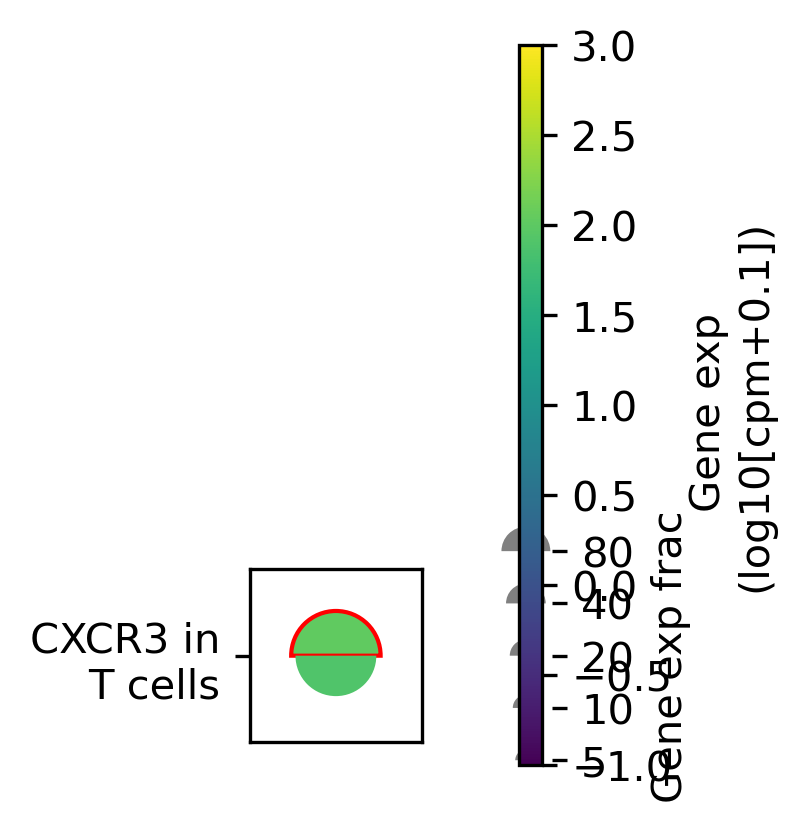

In [5]:
s_mushrooms([{'CXCR3': ['T_cells']}])

{'fig': <Figure size 468x540 with 3 Axes>, 'ax': [<AxesSubplot:>]}

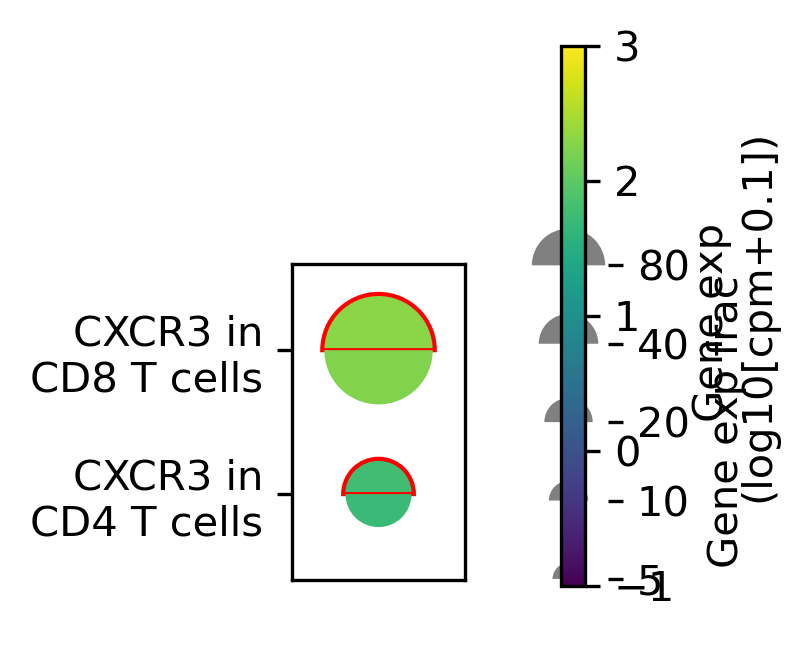

In [6]:
s_mushrooms([{'CXCR3': ['CD4_T_cells', 'CD8_T_cells']}])